## EDA & PREPROCESSING

In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix
from collections import Counter
import seaborn as sns
import tqdm
import glob
import os
import json
from PIL import Image
import xml.etree.ElementTree as ET
import pprint
pp = pprint.PrettyPrinter(indent=4)
import albumentations as A
from albumentations.pytorch import ToTensorV2

import torch
from torch import nn, optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, ConcatDataset, random_split
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision import transforms
import torchvision.ops as ops
from torch.utils.data import distributed, RandomSampler, SequentialSampler
import random
import cv2

In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [27]:
TRAIN_PATH = "/kaggle/input/aquarium-data-cots/aquarium_pretrain/train"
VAL_PATH = "/kaggle/input/aquarium-data-cots/aquarium_pretrain/valid"
TEST_PATH = "/kaggle/input/aquarium-data-cots/aquarium_pretrain/test"

TRAIN_LABELS = TRAIN_PATH + "/labels"
VAL_LABELS = VAL_PATH + "/labels"
TEST_LABELS = TEST_PATH + "/labels"

TRAIN_IMAGES = TRAIN_PATH + "/images"
VAL_IMAGES = VAL_PATH + "/images"
TEST_IMAGES = TEST_PATH + "/images"

data = "../data/aquarium_pretrain/data.yaml"

In [28]:
classes = ["fish", "jellyfish", "penguin", "puffin", "shark", "starfish", "stingray"]
Idx2Label = {idx: label for idx, label in enumerate(classes)}
Label2Index = {label: idx for idx, label in Idx2Label.items()}
print("Index to Label Mapping:", Idx2Label)
print("Label to Index Mapping:", Label2Index)

Index to Label Mapping: {0: 'fish', 1: 'jellyfish', 2: 'penguin', 3: 'puffin', 4: 'shark', 5: 'starfish', 6: 'stingray'}
Label to Index Mapping: {'fish': 0, 'jellyfish': 1, 'penguin': 2, 'puffin': 3, 'shark': 4, 'starfish': 5, 'stingray': 6}


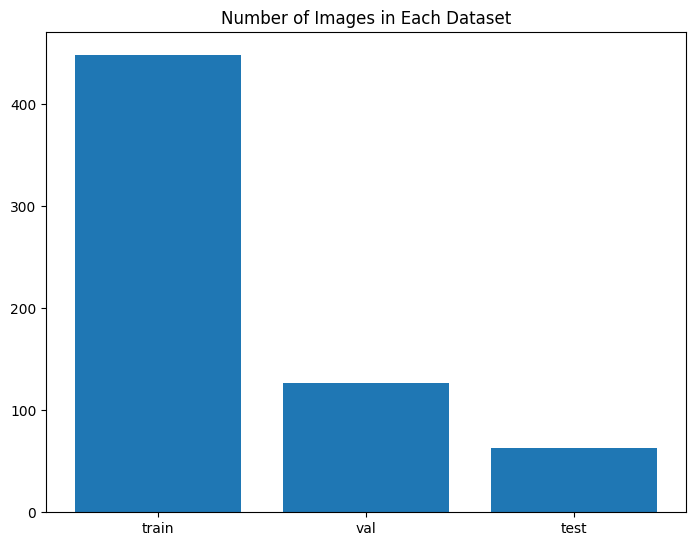

In [29]:
def plot_num_images(data, title):
    fig = plt.figure()
    ax = fig.add_axes([0,0,1,1])
    ax.bar(data.keys(), data.values())
    plt.title(title)
    plt.show()
    
def get_num_images(path):
    return len(os.listdir(path))

plot_num_images({ "train": get_num_images(TRAIN_IMAGES), "val": get_num_images(VAL_IMAGES), "test": get_num_images(TEST_IMAGES) }, "Number of Images in Each Dataset")

In [30]:
def count_objects_per_images(image_dir, label_dir, object_count, total_object_count):
    image_files = sorted(os.listdir(image_dir))
    for image_file in tqdm.tqdm(image_files):
        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        f = open(label_path, "r")
        lines = f.readlines()
        total_object_count.append(len(lines))
        for line in lines:
            object_count[Idx2Label[int(line.split()[0])]] = object_count.get(Idx2Label[int(line.split()[0])], 0) + 1
        f.close()
        
train_object_count = {}
val_object_count = {}
test_object_count = {}

total_object_per_train_count = []
total_object_per_val_count = []
total_object_per_test_count = []

count_objects_per_images(TRAIN_IMAGES, TRAIN_LABELS, train_object_count, total_object_per_train_count)
count_objects_per_images(VAL_IMAGES, VAL_LABELS, val_object_count, total_object_per_val_count)
count_objects_per_images(TEST_IMAGES, TEST_LABELS, test_object_count, total_object_per_test_count)

100%|██████████| 63/63 [00:00<00:00, 254.64it/s]


In [31]:
pp.pprint(train_object_count)
print()
pp.pprint(val_object_count)
print()
pp.pprint(test_object_count)

{   'fish': 1961,
    'jellyfish': 385,
    'penguin': 330,
    'puffin': 175,
    'shark': 259,
    'starfish': 78,
    'stingray': 136}

{   'fish': 459,
    'jellyfish': 155,
    'penguin': 104,
    'puffin': 74,
    'shark': 57,
    'starfish': 27,
    'stingray': 33}

{   'fish': 249,
    'jellyfish': 154,
    'penguin': 82,
    'puffin': 35,
    'shark': 38,
    'starfish': 11,
    'stingray': 15}


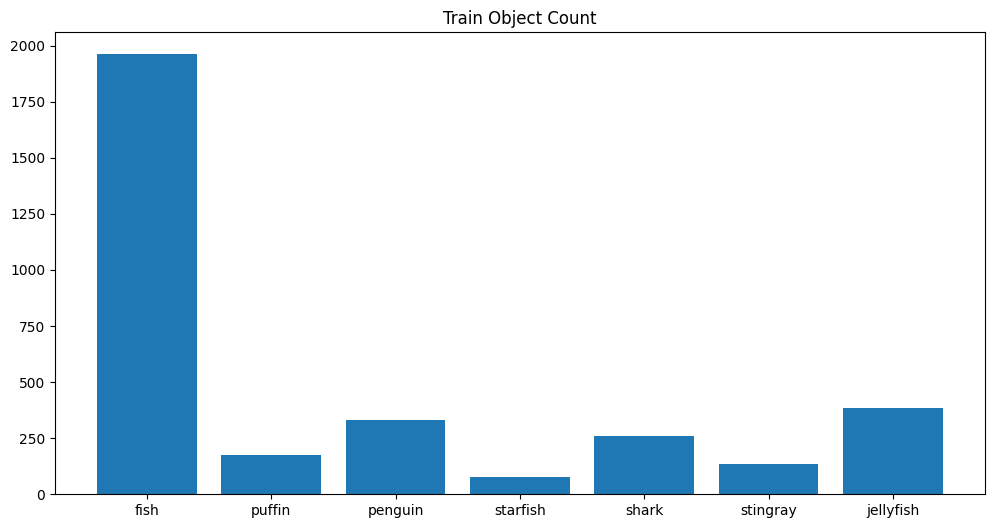

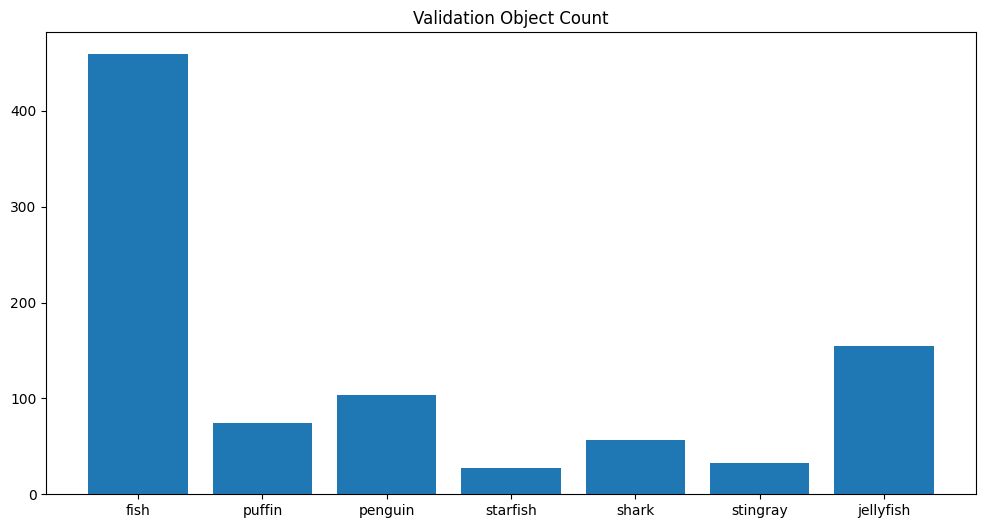

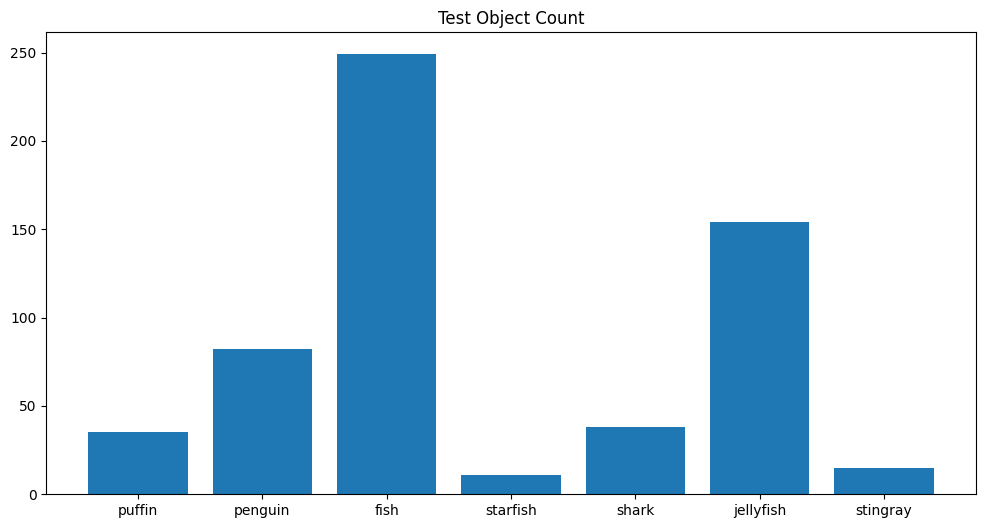

In [32]:
def plot_object_count(object_count, title):
    plt.figure(figsize=(12, 6))
    plt.bar(object_count.keys(), object_count.values())
    plt.title(title)
    plt.show()
    
plot_object_count(train_object_count, "Train Object Count")
plot_object_count(val_object_count, "Validation Object Count")
plot_object_count(test_object_count, "Test Object Count")

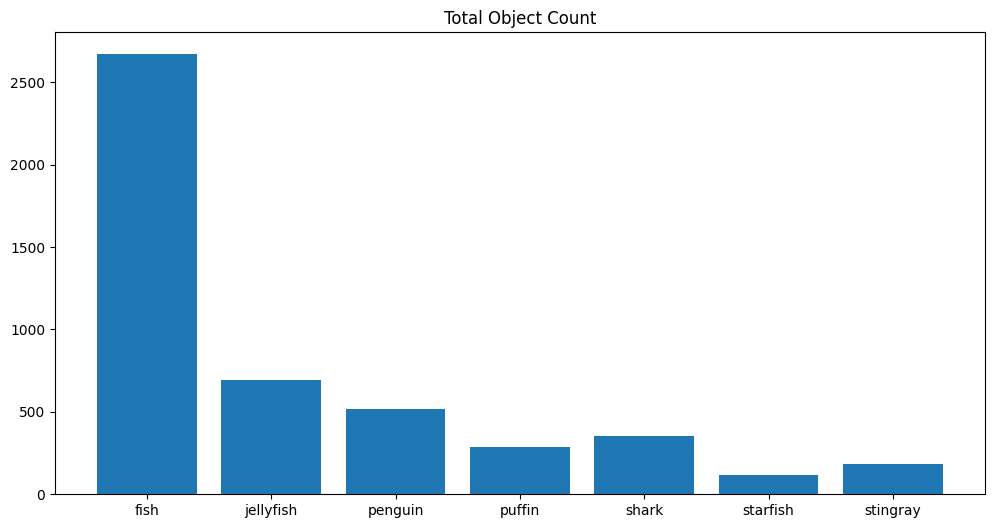

In [33]:
total_object_count = {label: train_object_count.get(label, 0) + val_object_count.get(label, 0) + test_object_count.get(label, 0) for label in classes}
plot_object_count(total_object_count, "Total Object Count")

Number of classes in the datasets are shown, as can be seen fishes are the most common class in the dataset, followed by jellyfish and penguins. This imbalance in the dataset can affect the performance of the model, so we will use techniques like data augmentation and OHEM to address this issue.

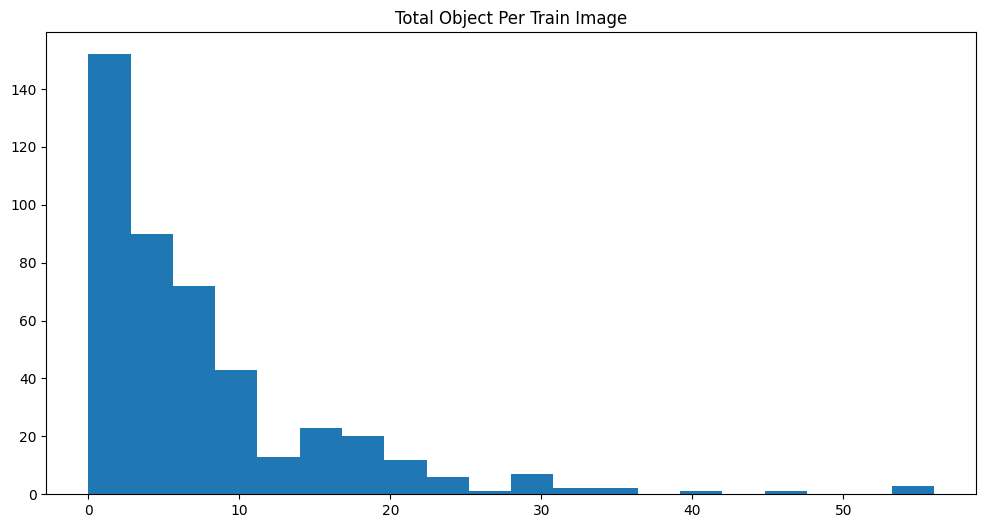

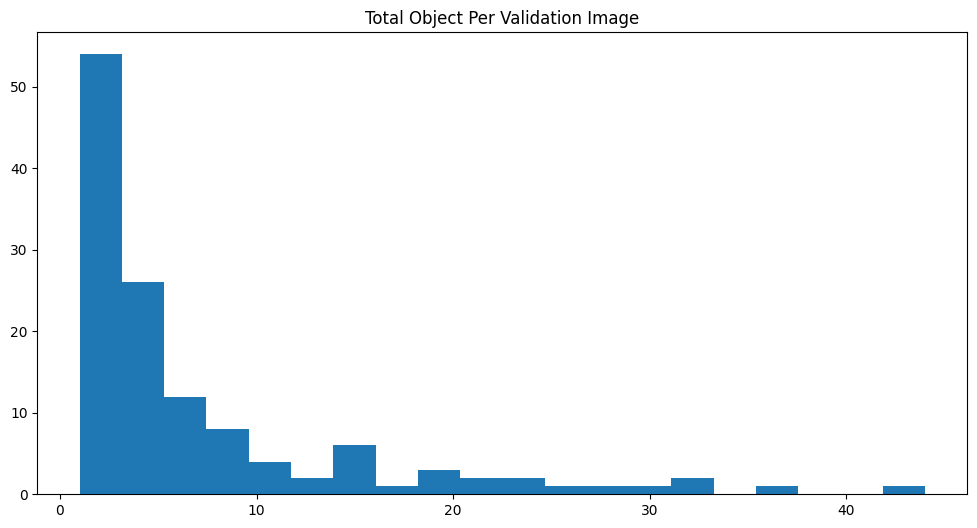

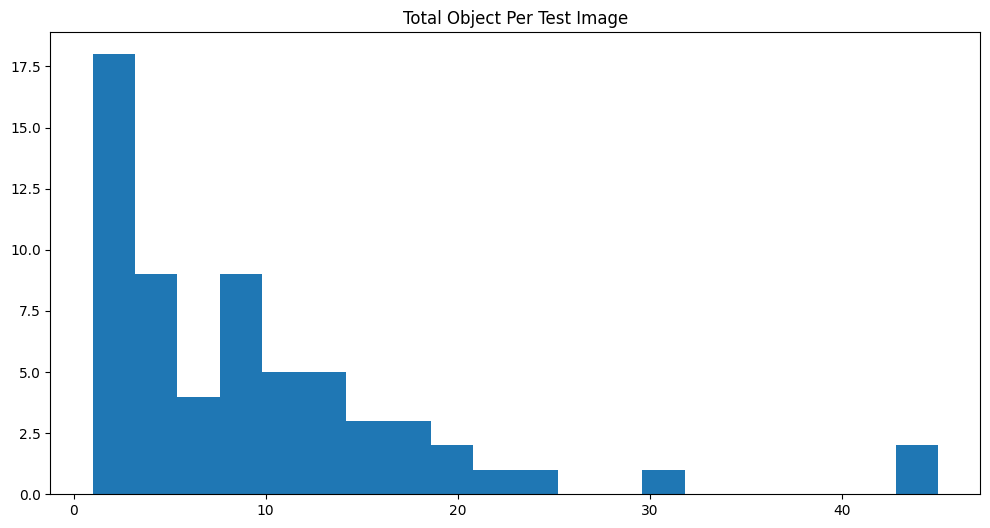

In [34]:
def plot_total_object_per_image(total_object_per_image, title):
    plt.figure(figsize=(12, 6))
    plt.hist(total_object_per_image, bins=20)
    plt.title(title)
    plt.show()
    
plot_total_object_per_image(total_object_per_train_count, "Total Object Per Train Image")
plot_total_object_per_image(total_object_per_val_count, "Total Object Per Validation Image")
plot_total_object_per_image(total_object_per_test_count, "Total Object Per Test Image")

The number of objects per image in all the datasets is shown, as can be seen most of the images contain 1-2 objects. All datasets have a similar distribution of objects per image, so we can use the same techniques for all datasets.

In [35]:
def get_bbox_sizes(image_dir, label_dir, sizes):
    image_files = sorted(os.listdir(image_dir))
    for image_file in tqdm.tqdm(image_files):
        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        f = open(label_path, "r")
        lines = f.readlines()
        for line in lines:
            sizes.append(float(line.split()[3]) * float(line.split()[4]))
        f.close()
        
train_sizes = []
val_sizes = []
test_sizes = []

get_bbox_sizes(TRAIN_IMAGES, TRAIN_LABELS, train_sizes)
get_bbox_sizes(VAL_IMAGES, VAL_LABELS, val_sizes)
get_bbox_sizes(TEST_IMAGES, TEST_LABELS, test_sizes)

100%|██████████| 63/63 [00:00<00:00, 1409.44it/s]


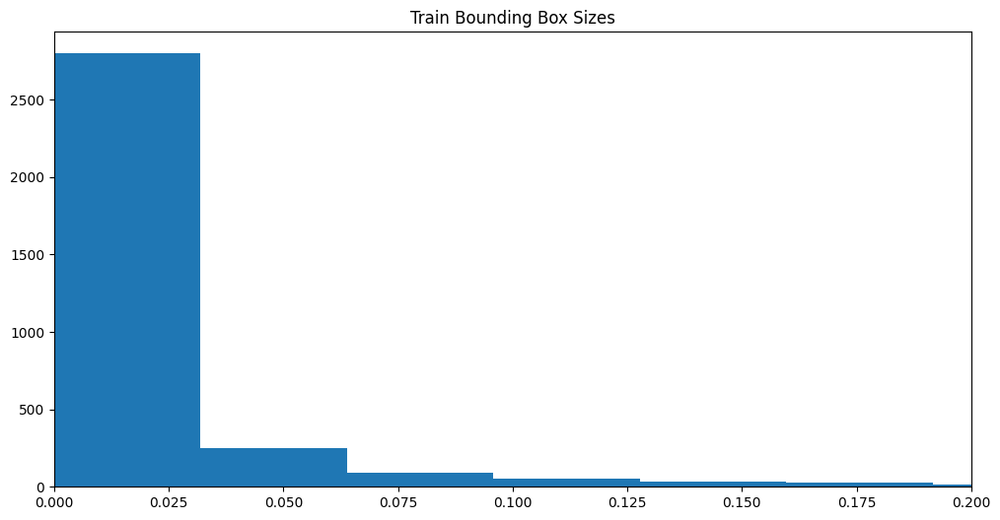

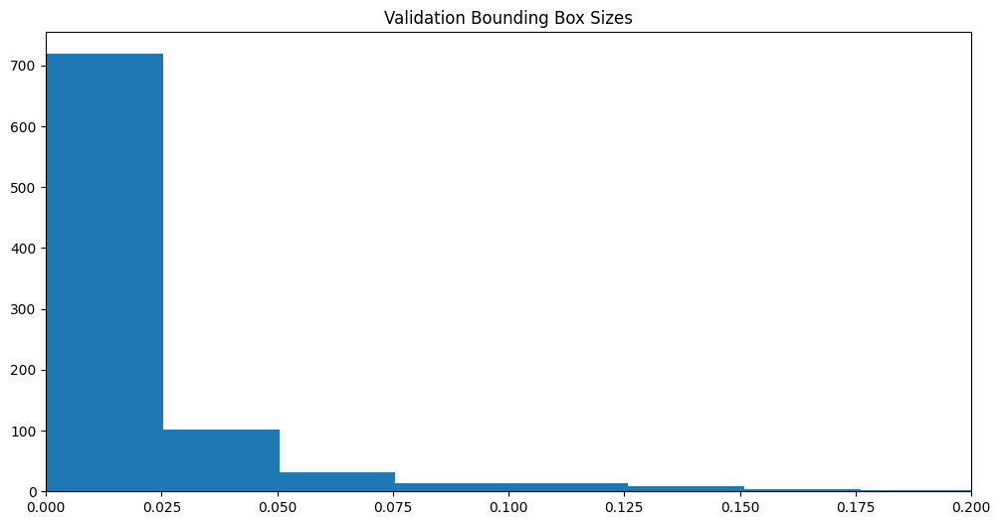

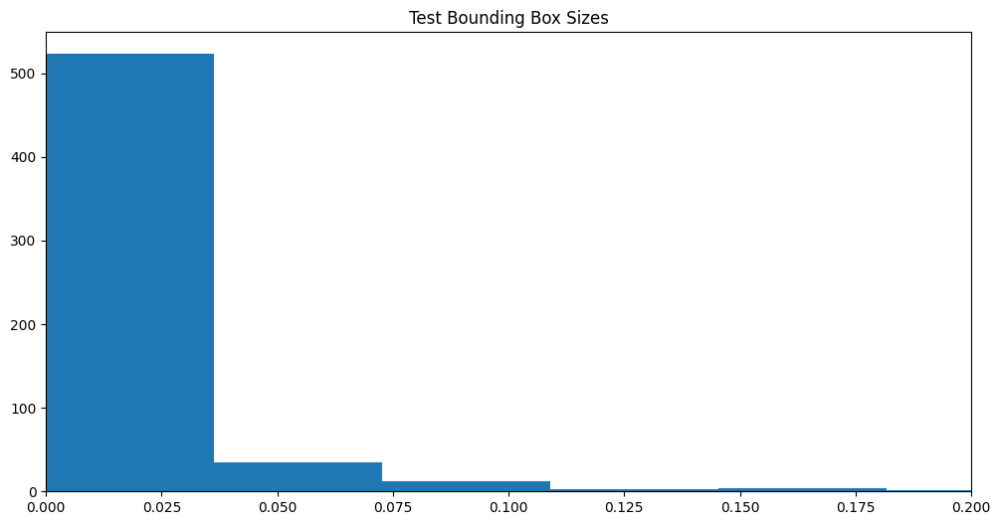

In [36]:
def plot_bbox_sizes(sizes, title):
    plt.figure(figsize=(12, 6))
    plt.hist(sizes, bins=20)
    plt.title(title)
    plt.xlim(0, .2)
    plt.show()
    
plot_bbox_sizes(train_sizes, "Train Bounding Box Sizes")
plot_bbox_sizes(val_sizes, "Validation Bounding Box Sizes")
plot_bbox_sizes(test_sizes, "Test Bounding Box Sizes")

The distribution of bounding box sizes in the datasets is shown. It can help us understand the scale of the objects in the images and choose an appropriate anchor size for the model. It can also be really helpful for our anchor generation.

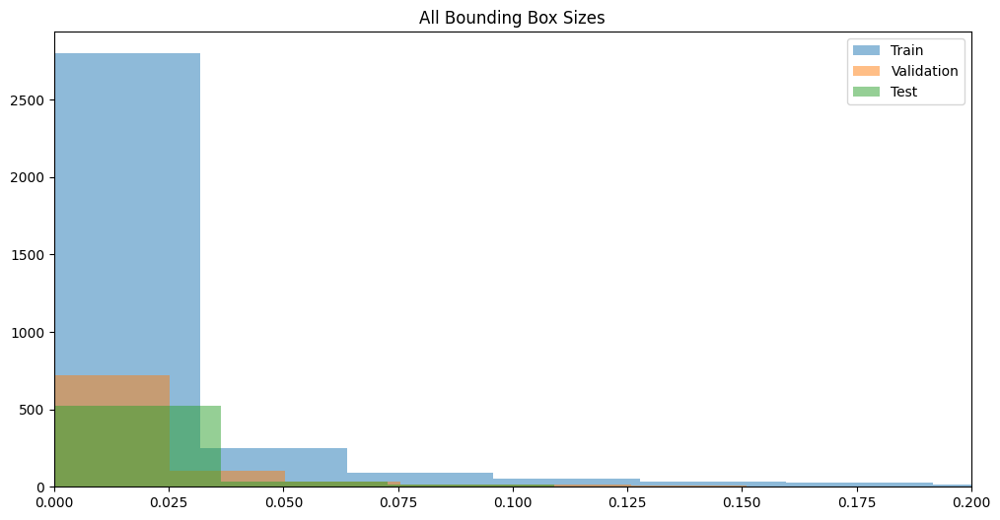

In [37]:
def plot_all_bbox_sizes(train_sizes, val_sizes, test_sizes, title):
    plt.figure(figsize=(12, 6))
    plt.hist(train_sizes, bins=20, alpha=0.5, label="Train")
    plt.hist(val_sizes, bins=20, alpha=0.5, label="Validation")
    plt.hist(test_sizes, bins=20, alpha=0.5, label="Test")
    plt.title(title)
    plt.xlim(0, .2)
    plt.legend()
    plt.show()
    
plot_all_bbox_sizes(train_sizes, val_sizes, test_sizes, "All Bounding Box Sizes")

In [38]:
def count_width_height(image_dir, label_dir, width_height):
    image_files = sorted(os.listdir(image_dir))
    for image_file in tqdm.tqdm(image_files):
        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        f = open(label_path, "r")
        lines = f.readlines()
        for line in lines:
            width_height.append((float(line.split()[3]), float(line.split()[4])))
        f.close()
        
train_width_height = []
val_width_height = []
test_width_height = []

count_width_height(TRAIN_IMAGES, TRAIN_LABELS, train_width_height)
count_width_height(VAL_IMAGES, VAL_LABELS, val_width_height)
count_width_height(TEST_IMAGES, TEST_LABELS, test_width_height)

100%|██████████| 63/63 [00:00<00:00, 1912.21it/s]


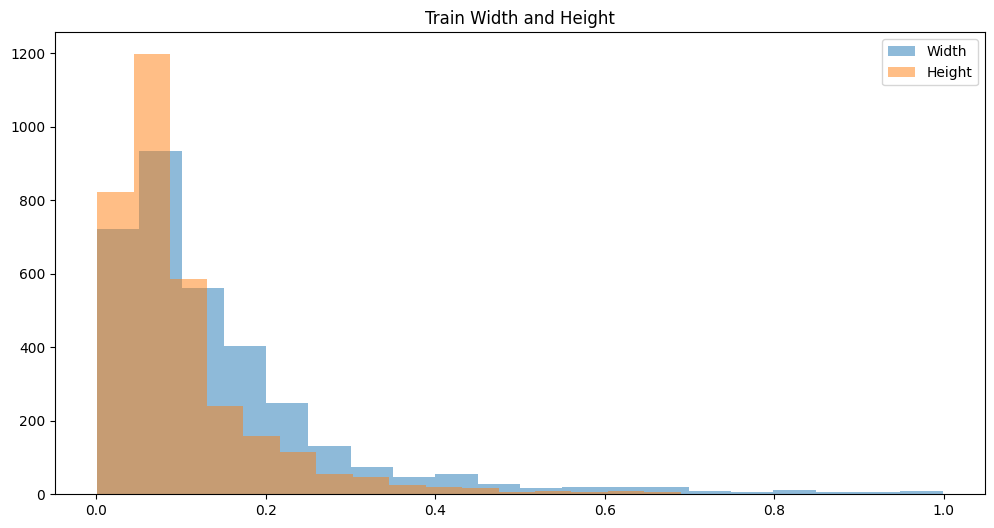

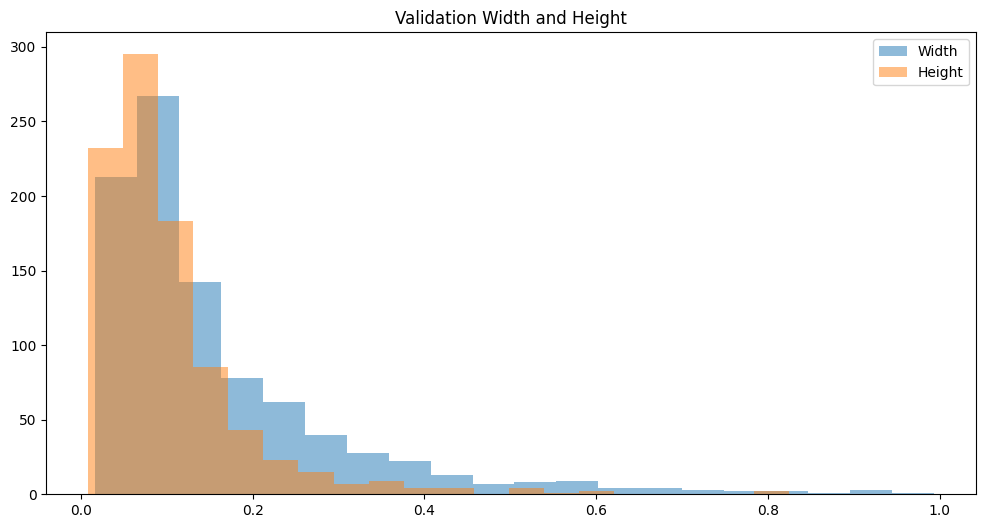

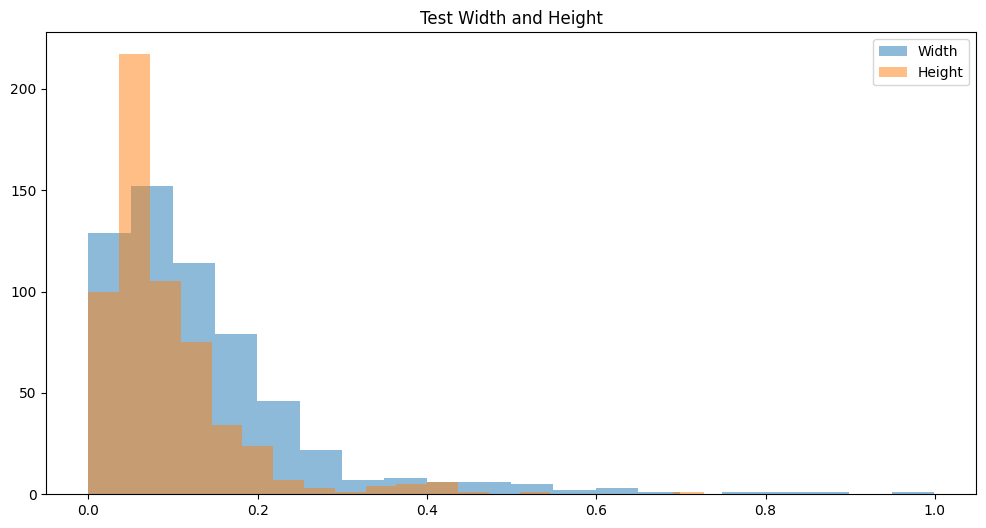

In [39]:
def plot_width_height(width_height, title):
    width, height = zip(*width_height)
    plt.figure(figsize=(12, 6))
    plt.hist(width, bins=20, alpha=0.5, label="Width")
    plt.hist(height, bins=20, alpha=0.5, label="Height")
    plt.title(title)
    plt.legend()
    plt.show()
    
plot_width_height(train_width_height, "Train Width and Height")
plot_width_height(val_width_height, "Validation Width and Height")
plot_width_height(test_width_height, "Test Width and Height")

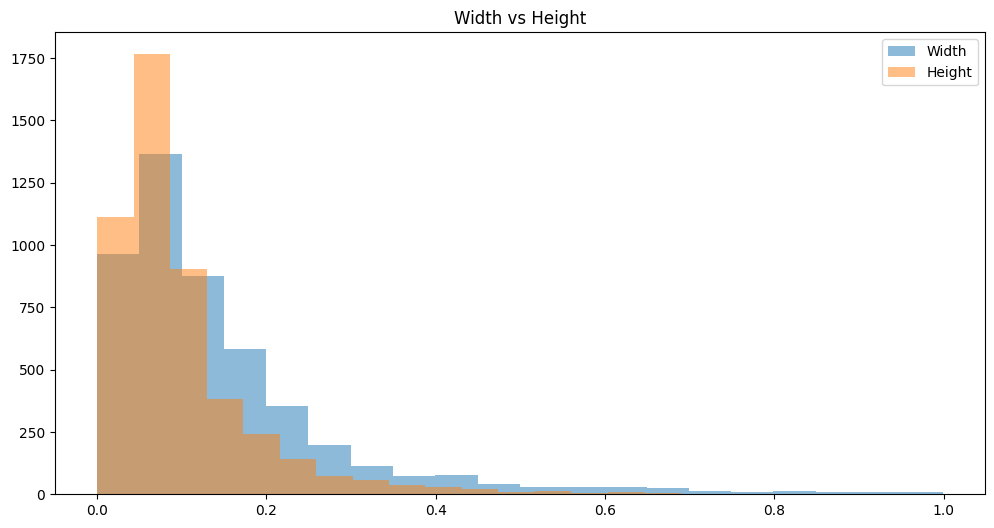

In [40]:
total_width_height = train_width_height + val_width_height + test_width_height
plot_width_height(total_width_height, "Width vs Height")

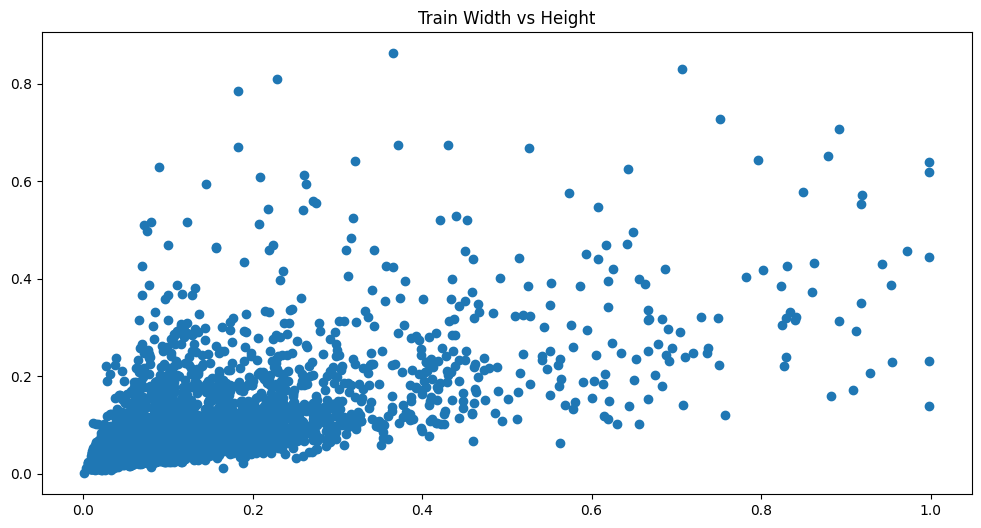

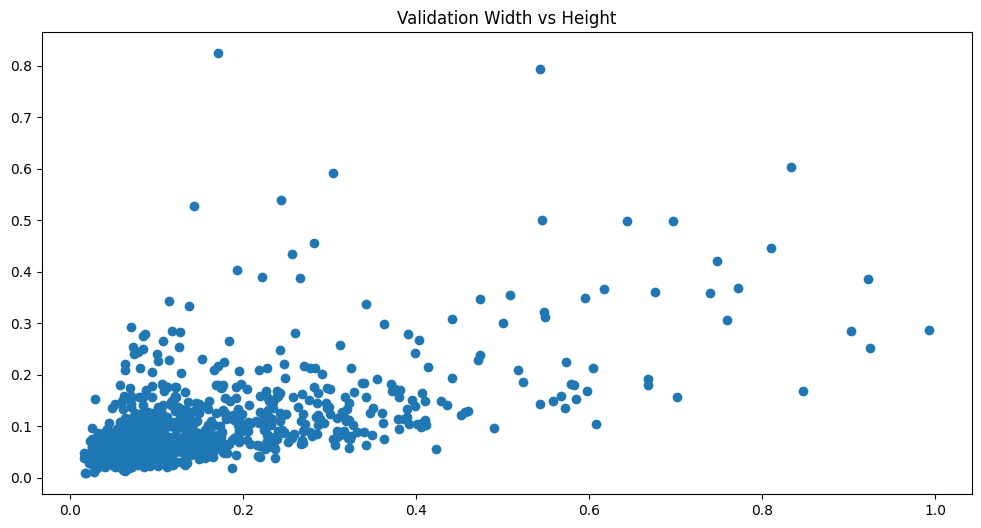

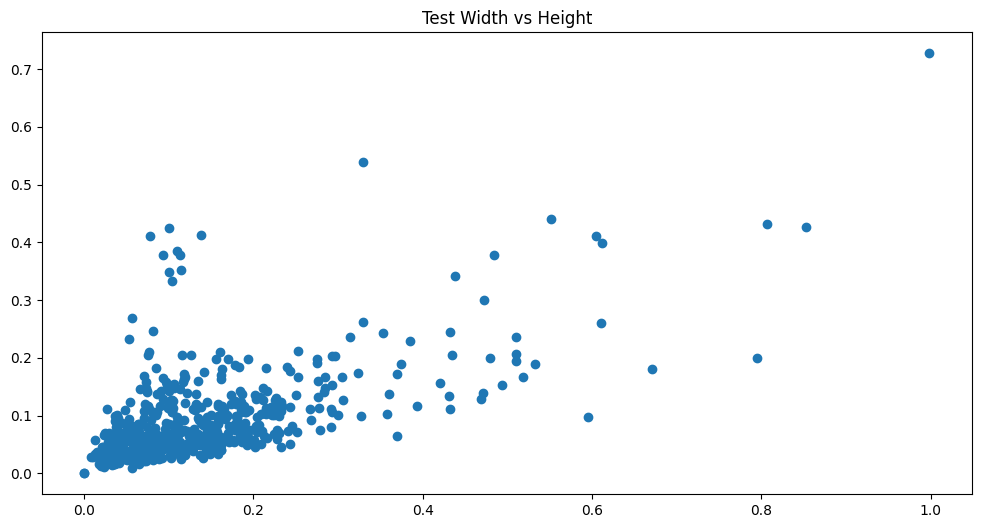

In [41]:
def plot_width_height_scatter(width_height, title):
    width, height = zip(*width_height)
    plt.figure(figsize=(12, 6))
    plt.scatter(width, height)
    plt.title(title)
    plt.show()
    
plot_width_height_scatter(train_width_height, "Train Width vs Height")
plot_width_height_scatter(val_width_height, "Validation Width vs Height")
plot_width_height_scatter(test_width_height, "Test Width vs Height")

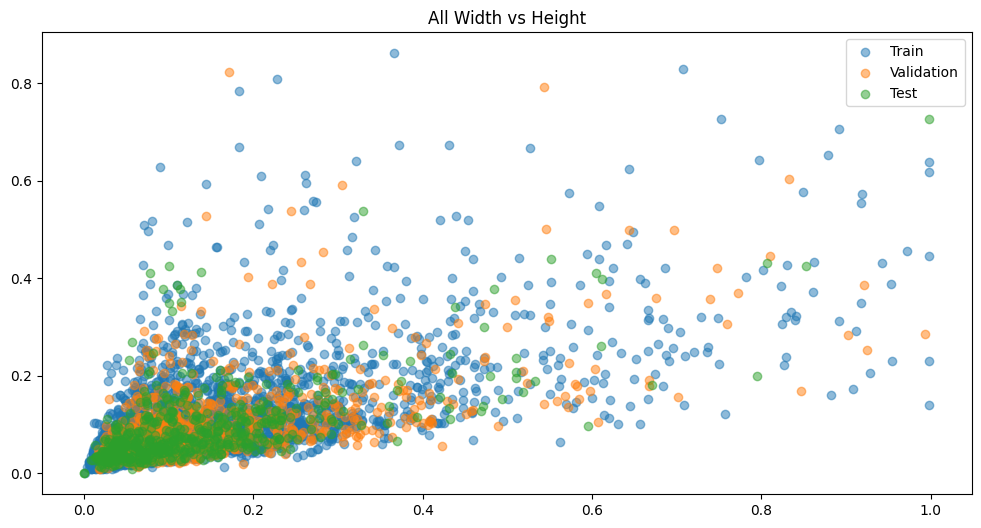

In [42]:
def plot_all_width_height_scatter(train_width_height, val_width_height, test_width_height, title):
    train_width, train_height = zip(*train_width_height)
    val_width, val_height = zip(*val_width_height)
    test_width, test_height = zip(*test_width_height)
    plt.figure(figsize=(12, 6))
    plt.scatter(train_width, train_height, alpha=0.5, label="Train")
    plt.scatter(val_width, val_height, alpha=0.5, label="Validation")
    plt.scatter(test_width, test_height, alpha=0.5, label="Test")
    plt.title(title)
    plt.legend()
    plt.show()
    
plot_all_width_height_scatter(train_width_height, val_width_height, test_width_height, "All Width vs Height")

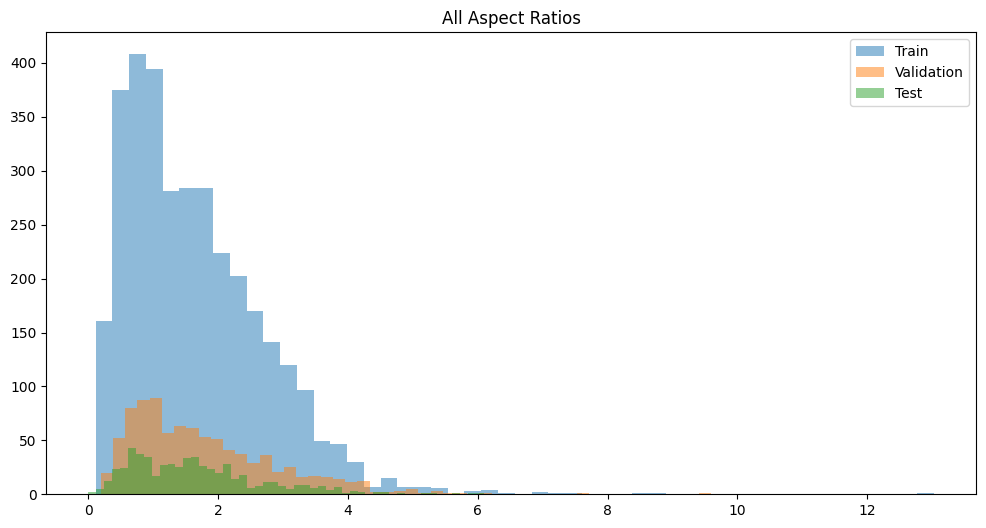

In [43]:
def plot_all_aspect_ratios(train_width_height, val_width_height, test_width_height, title):
    EPSILON = 1e-6
            
    train_aspect_ratio = [w / h if h != 0 else w / (h + EPSILON) for w, h in train_width_height] 
    val_aspect_ratio = [w / h if h != 0 else w / (h + EPSILON) for w, h in val_width_height]
    test_aspect_ratio = [w / h if h != 0 else w / (h + EPSILON) for w, h in test_width_height]
    
    plt.figure(figsize=(12, 6))
    plt.hist(train_aspect_ratio, alpha=0.5, label="Train", bins=50)
    plt.hist(val_aspect_ratio, alpha=0.5, label="Validation", bins=50)
    plt.hist(test_aspect_ratio, alpha=0.5, label="Test", bins=50)
    plt.title(title)
    plt.legend()
    plt.show()

plot_all_aspect_ratios(train_width_height, val_width_height, test_width_height, "All Aspect Ratios")

The width and height of bounding boxes can also help us understand the aspect ratio of the objects in the images and choose an appropriate anchor aspect ratio for the model.

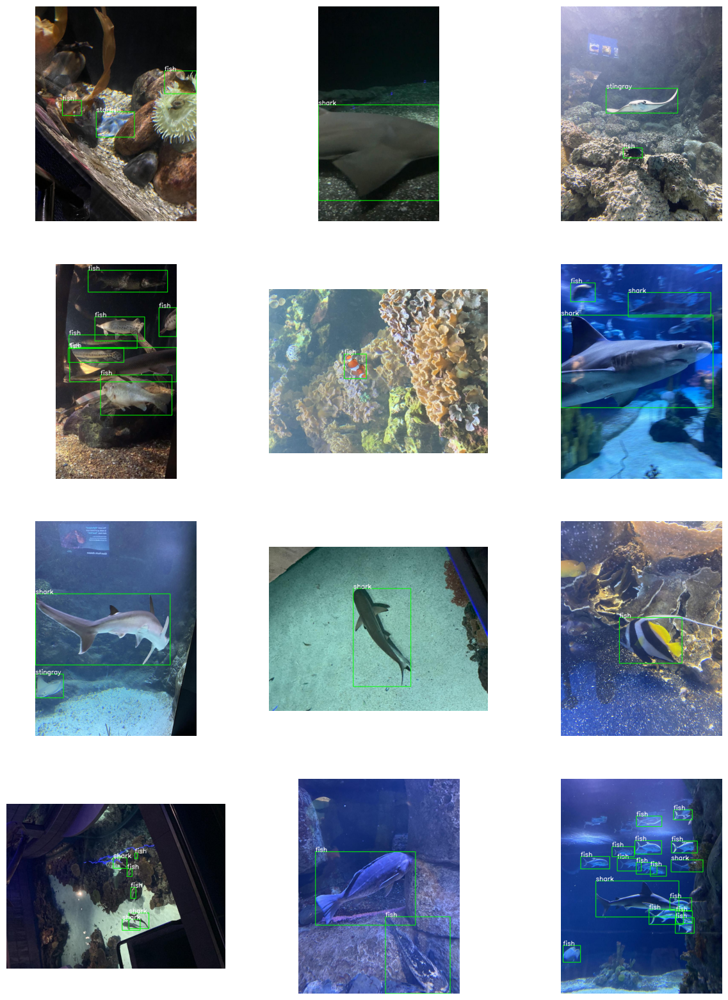

In [44]:
def visualize_image_with_annotation_bounding_boxes(image_dir, label_dir):
    image_files = sorted(os.listdir(image_dir))

    sample_image_files = random.sample(image_files, 12)

    fig, axs = plt.subplots(4, 3, figsize=(15, 20))

    for i, image_file in enumerate(sample_image_files):
        row = i // 3
        col = i % 3

        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        f = open(label_path, "r")

        for label in f:
            class_id, x_center, y_center, width, height = map(float, label.split())
            h, w, _ = image.shape
            x_min = int((x_center - width / 2) * w)
            y_min = int((y_center - height / 2) * h)
            x_max = int((x_center + width / 2) * w)
            y_max = int((y_center + height / 2) * h)
            cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
            cv2.putText(
                image,
                Idx2Label[int(class_id)],
                (x_min, y_min),
                cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=1,
                color=(255, 255, 255),
                thickness=2,
            )

        axs[row, col].imshow(image)
        axs[row, col].axis("off")

    plt.show()


visualize_image_with_annotation_bounding_boxes(TRAIN_IMAGES, TRAIN_LABELS)

## Preprocessing



In [45]:
def resize(im, img_size=640, square=False):
    if square:
        im = cv2.resize(im, (img_size, img_size))
    else:
        h0, w0 = im.shape[:2] 
        r = img_size / max(h0, w0) 
        if r != 1:
            im = cv2.resize(im, (int(w0 * r), int(h0 * r)))
    return im

In [46]:
DESTINATION_PATH = "./aquarium_pretrain"

TRAIN_DESTINATION = DESTINATION_PATH + "/train"
VAL_DESTINATION = DESTINATION_PATH + "/valid"
TEST_DESTINATION = DESTINATION_PATH + "/test"

In [47]:
def resize_dataset_and_update_labels(image_dir, label_dir, image_dest, label_dest, img_size=640, square=False):
    image_files = sorted(os.listdir(image_dir))
    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        image = resize(cv2.imread(image_path), img_size, square)
        cv2.imwrite(os.path.join(image_dest, image_file), image)
        
        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        f = open(label_path, "r")
        lines = f.readlines()
        f.close()
        
        f = open(os.path.join(label_dest, image_file[:-4] + ".txt"), "w")
        for line in lines:
            class_id, x_center, y_center, width, height = map(float, line.split())
            x_center *= img_size
            y_center *= img_size
            width *= img_size
            height *= img_size
            f.write("{} {} {} {} {}\n".format(int(class_id), x_center, y_center, width, height))
        f.close()

In [48]:
import os
import cv2

def resize_dataset_and_update_labels(image_dir, label_dir, image_dest, label_dest, img_size=640, square=False):
    if not os.path.exists(image_dest):
        os.makedirs(image_dest)
    if not os.path.exists(label_dest):
        os.makedirs(label_dest)

    image_files = sorted(os.listdir(image_dir))
    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        
        # Check if the image was loaded correctly
        if image is None:
            print(f"Could not read image {image_file}, skipping.")
            continue
        
        # Resize image
        if square:
            image = cv2.resize(image, (img_size, img_size))
        else:
            scale = img_size / max(image.shape[:2])
            new_size = (int(image.shape[1] * scale), int(image.shape[0] * scale))
            image = cv2.resize(image, new_size)
        
        cv2.imwrite(os.path.join(image_dest, image_file), image)
        
        # Process labels if they exist
        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        if not os.path.exists(label_path):
            print(f"No label file for image {image_file}, skipping label.")
            continue
        
        with open(label_path, "r") as f:
            lines = f.readlines()
        
        with open(os.path.join(label_dest, image_file[:-4] + ".txt"), "w") as f:
            for line in lines:
                try:
                    class_id, x_center, y_center, width, height = map(float, line.split())
                    x_center *= img_size
                    y_center *= img_size
                    width *= img_size
                    height *= img_size
                    f.write(f"{int(class_id)} {x_center} {y_center} {width} {height}\n")
                except ValueError as e:
                    print(f"Error in label for {image_file}: {e}")


In [49]:
resize_dataset_and_update_labels(TRAIN_IMAGES, TRAIN_LABELS, TRAIN_DESTINATION + "/images", TRAIN_DESTINATION + "/labels")
resize_dataset_and_update_labels(VAL_IMAGES, VAL_LABELS, VAL_DESTINATION + "/images", VAL_DESTINATION + "/labels")
resize_dataset_and_update_labels(TEST_IMAGES, TEST_LABELS, TEST_DESTINATION + "/images", TEST_DESTINATION + "/labels")

In [50]:
def get_train_aug():
    return A.Compose(
        [
            A.OneOf(
                [
                    A.Blur(blur_limit=3, p=0.5),
                    A.MotionBlur(blur_limit=3, p=0.5),
                    A.MedianBlur(blur_limit=3, p=0.5),
                ],
                p=0.5,
            ),
            A.ToGray(p=0.1),
            A.RandomBrightnessContrast(p=0.1),
            A.ColorJitter(p=0.1),
            A.RandomGamma(p=0.1),
            A.RandomRotate90(p=0.5),
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.ShiftScaleRotate(p=0.5),
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )


def get_train_transform():
    return A.Compose(
        [
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )

In [51]:
def get_valid_transform():
    return A.Compose(
        [
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )


def infer_transforms(image):
    transform = transforms.Compose(
        [
            transforms.ToPILImage(),
            transforms.ToTensor(),
        ]
    )
    return transform(image)

In [52]:
def preprocess(image_name, image_dir, label_dir):
    image_path = os.path.sep.join([image_dir, image_name])
    name = image_name.split(".")[0]
    label_name = name + ".txt"
    label_path = os.path.sep.join([label_dir, label_name])

    return image_path, label_path, label_name


def draw_rect(img, bboxes, color=(255, 0, 0)):
    img = img.copy()
    height, width = img.shape[:2]
    for bbox in bboxes:
        center_x, center_y, w, h = bbox[0], bbox[1], bbox[2], bbox[3]
        x = int((center_x - w / 2) * width)
        w = int(w * width)
        y = int((center_y - h / 2) * height)
        h = int(h * height)
        img = cv2.rectangle(img, (x, y), (x + w, y + h), color, 1)
    return img


def read_img(image_path, cvt_color=True):
    img = cv2.imread(image_path)
    if cvt_color:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


def save_img(image, save_path, jpg_quality=None):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    if jpg_quality:
        cv2.imwrite(save_path, image, [int(cv2.IMWRITE_JPEG_QUALITY), jpg_quality])
    else:
        cv2.imwrite(save_path, image)


def read_label(label_path):
    with open(label_path) as f:
        conts = f.readlines()

    bboxes = []
    class_labels = []
    for cont in conts:
        cont = cont.strip().split()
        center_x, center_y, w, h = (
            float(cont[1]),
            float(cont[2]),
            float(cont[3]),
            float(cont[4]),
        )
        bboxes.append([center_x, center_y, w, h])
        class_labels.append(cont[0])
    return (bboxes, class_labels)


def display_img(image_path, label_path):
    img = read_img(image_path, cvt_color=False)
    bboxes = read_label(label_path)[0]
    img = draw_rect(img, bboxes)
    cv2.imshow("Image", img)
    cv2.waitKey(0)


def save_label(bboxes, class_labels, label_path):
    tem_lst = []
    for i, bbox in enumerate(bboxes):
        tem_lst.append(
            class_labels[i]
            + " "
            + str(bbox[0])
            + " "
            + str(bbox[1])
            + " "
            + str(bbox[2])
            + " "
            + str(bbox[3])
            + "\n"
        )

    with open(label_path, "w") as f:
        f.writelines(tem_lst)

In [53]:
def random_crop_savebboxes(
    image_name, image_dir, label_dir, expected_h, expected_w, min_area, min_visibility
):
    image_path, label_path, _ = preprocess(image_name, image_dir, label_dir)

    (bboxes, class_labels) = read_label(label_path)

    transform = A.Compose(
        [A.RandomResizedCrop(expected_h, expected_w)],
        bbox_params=A.BboxParams(
            format="yolo",
            label_fields=["class_labels"],
            min_area=min_area,
            min_visibility=min_visibility,
        ),
    )

    transformed = transform(image=read_img(image_path), bboxes=bboxes, class_labels=class_labels)
    transformed_image = transformed["image"]
    transformed_bboxes = transformed["bboxes"]
    transformed_class_labels = transformed["class_labels"]

    return transformed_image, transformed_bboxes, transformed_class_labels

In [54]:
def mosaic(
    image_file_list,
    image_dir,
    label_dir,
    output_image_dir,
    output_label_dir,
    mo_w,
    mo_h,
    scale_x,
    scale_y,
    min_area,
    min_visibility,
    show_image=False,
):

    new_img = np.zeros((mo_h, mo_w, 3), dtype="uint8")

    div_point_x = int(mo_w * scale_x)
    div_point_y = int(mo_h * scale_y)

    for i in range(len(image_file_list)):
        if i == 0:
            w0 = div_point_x
            h0 = div_point_y
            img_0, bboxes_0, class_labels_0 = random_crop_savebboxes(
                image_file_list[0],
                image_dir,
                label_dir,
                h0,
                w0,
                min_area,
                min_visibility,
            )
            new_img[:div_point_y, :div_point_x, :] = img_0

            if len(bboxes_0) == 0:
                bboxes_0_new = []
            else:
                bboxes_0_new = np.zeros((len(bboxes_0), 4))
                bboxes_0_new = bboxes_0_new.tolist()

            for i, box in enumerate(bboxes_0):
                bboxes_0_new[i][0] = box[0] * scale_x
                bboxes_0_new[i][2] = box[2] * scale_x

                bboxes_0_new[i][1] = box[1] * scale_y
                bboxes_0_new[i][3] = box[3] * scale_y

        elif i == 1:
            w1 = mo_w - div_point_x
            h1 = div_point_y
            img_1, bboxes_1, class_labels_1 = random_crop_savebboxes(
                image_file_list[1],
                image_dir,
                label_dir,
                h1,
                w1,
                min_area,
                min_visibility,
            )
            new_img[:div_point_y, div_point_x:, :] = img_1

            if len(bboxes_1) == 0:
                bboxes_1_new = []
            else:
                bboxes_1_new = np.zeros((len(bboxes_1), 4))
                bboxes_1_new = bboxes_1_new.tolist()

            for i, box in enumerate(bboxes_1):
                bboxes_1_new[i][0] = box[0] * (1 - scale_x) + scale_x
                bboxes_1_new[i][2] = box[2] * (1 - scale_x)

                bboxes_1_new[i][1] = box[1] * scale_y
                bboxes_1_new[i][3] = box[3] * scale_y

        elif i == 2:
            w2 = div_point_x
            h2 = mo_h - div_point_y
            img_2, bboxes_2, class_labels_2 = random_crop_savebboxes(
                image_file_list[2],
                image_dir,
                label_dir,
                h2,
                w2,
                min_area,
                min_visibility,
            )
            new_img[div_point_y:, :div_point_x, :] = img_2

            if len(bboxes_2) == 0:
                bboxes_2_new = []
            else:
                bboxes_2_new = np.zeros((len(bboxes_2), 4))
                bboxes_2_new = bboxes_2_new.tolist()

            for i, box in enumerate(bboxes_2):
                bboxes_2_new[i][0] = box[0] * scale_x
                bboxes_2_new[i][2] = box[2] * scale_x

                bboxes_2_new[i][1] = box[1] * (1 - scale_y) + scale_y
                bboxes_2_new[i][3] = box[3] * (1 - scale_y)

        else:
            w3 = mo_w - div_point_x
            h3 = mo_h - div_point_y
            img_3, bboxes_3, class_labels_3 = random_crop_savebboxes(
                image_file_list[3],
                image_dir,
                label_dir,
                h3,
                w3,
                min_area,
                min_visibility,
            )
            new_img[div_point_y:, div_point_x:, :] = img_3

            if len(bboxes_3) == 0:
                bboxes_3_new = []
            else:
                bboxes_3_new = np.zeros((len(bboxes_3), 4))
                bboxes_3_new = bboxes_3_new.tolist()

            for i, box in enumerate(bboxes_3):
                bboxes_3_new[i][0] = box[0] * (1 - scale_x) + scale_x 
                bboxes_3_new[i][2] = box[2] * (1 - scale_x)

                bboxes_3_new[i][1] = box[1] * (1 - scale_y) + scale_y 
                bboxes_3_new[i][3] = box[3] * (1 - scale_y)

    new_class_labels = class_labels_0 + class_labels_1 + class_labels_2 + class_labels_3
    new_bboxes = bboxes_0_new + bboxes_1_new + bboxes_2_new + bboxes_3_new

    image_store_path = os.path.sep.join(
        [
            output_image_dir,
            + image_file_list[0].split(".")[0]
            + "_"
            + image_file_list[1].split(".")[0]
            + "_"
            + image_file_list[2].split(".")[0]
            + "_"
            + image_file_list[3].split(".")[0]
            + ".jpg",
        ]
    )
    label_store_path = os.path.sep.join(
        [
            output_label_dir,
            + image_file_list[0].split(".")[0]
            + "_"
            + image_file_list[1].split(".")[0]
            + "_"
            + image_file_list[2].split(".")[0]
            + "_"
            + image_file_list[3].split(".")[0]
            + ".txt",
        ]
    )

    save_img(new_img, image_store_path)
    save_label(new_bboxes, new_class_labels, label_store_path)
    
    if show_image:
        cv2.imshow("Mosaic Image", new_img)
        cv2.waitKey(0)

In [55]:
def draw_text(
    img,
    text,
    font=cv2.FONT_HERSHEY_SIMPLEX,
    pos=(0, 0),
    font_scale=1,
    font_thickness=2,
    text_color=(0, 255, 0),
    text_color_bg=(0, 0, 0),
):
    offset = (5, 5)
    x, y = pos
    text_size, _ = cv2.getTextSize(text, font, font_scale, font_thickness)
    text_w, text_h = text_size
    rec_start = tuple(x - y for x, y in zip(pos, offset))
    rec_end = tuple(x + y for x, y in zip((x + text_w, y + text_h), offset))
    cv2.rectangle(img, rec_start, rec_end, text_color_bg, -1)
    cv2.putText(
        img,
        text,
        (x, int(y + text_h + font_scale - 1)),
        font,
        font_scale,
        text_color,
        font_thickness,
        cv2.LINE_AA,
    )
    return img


In [56]:
import os

def read_label(label_path):
    if not os.path.exists(label_path):
        print(f"Label file not found: {label_path}")
        return [], []
    with open(label_path) as f:
        conts = f.readlines()
    bboxes = []
    class_labels = []
    for cont in conts:
        class_id, x, y, w, h = map(float, cont.split())
        bboxes.append([x, y, w, h])
        class_labels.append(int(class_id))
    return bboxes, class_labels


In [57]:
def random_crop_savebboxes(
    image_name, image_dir, label_dir, expected_h, expected_w, min_area, min_visibility
):
    image_path, label_path, _ = preprocess(image_name, image_dir, label_dir)
    bboxes, class_labels = read_label(label_path) if os.path.exists(label_path) else ([], [])
    
    # Initialize bboxes and class_labels if not found
    if not bboxes:
        return None, [], []  # Adjust return values accordingly

    transform = A.Compose(
        [A.RandomResizedCrop(expected_h, expected_w)],
        bbox_params=A.BboxParams(
            format='yolo',
            min_area=min_area,
            min_visibility=min_visibility,
            label_fields=['class_labels']
        ),
    )

    transformed = transform(image=read_img(image_path), bboxes=bboxes, class_labels=class_labels)
    return transformed['image'], transformed['bboxes'], transformed['class_labels']


In [58]:
import os

label_dir = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train'
print(os.listdir(label_dir))


['labels', 'images']


In [73]:
import cv2
import albumentations as A
from albumentations.pytorch import ToTensorV2

def get_train_aug():
    return A.Compose(
        [
            A.OneOf(
                [
                    A.Blur(blur_limit=3, p=0.5),
                    A.MotionBlur(blur_limit=3, p=0.5),
                    A.MedianBlur(blur_limit=3, p=0.5),
                ],
                p=0.5,
            ),
            A.ToGray(p=0.1),
            A.RandomBrightnessContrast(p=0.1),
            A.ColorJitter(p=0.1),
            A.RandomGamma(p=0.1),
            A.RandomRotate90(p=0.5),
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.ShiftScaleRotate(p=0.5),
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )

def load_image(image_path):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Could not read image {image_path}. Skipping.")
        return None
    return image

# Example usage
image_path = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2444_jpeg_jpg.rf.cbd4c00116cf7dd7f0ea905031ea8774.jpg'
image = load_image(image_path)


In [77]:
bbox_info = {
    "IMG_2495_jpeg_jpg.rf.b0c357674c9856576d1561581f186c5b.jpg": [
        (0.15, 0.2, 0.35, 0.4),
        (0.45, 0.55, 0.65, 0.75),
        (0.3, 0.1, 0.5, 0.3)
    ]
}


In [86]:
import os
import cv2

image_directory = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images'
filenames = [
    'IMG_2473_jpeg_jpg.rf.6284677f9c781b0cfeec54981a17d573.jpg',
    'IMG_3134_jpeg_jpg.rf.50750ca778773042a3c46a1d3e480132.jpg',
    # Add all other filenames...
]

for filename in filenames:
    img_path = os.path.join(image_directory, filename)
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image {filename}. Skipping.")
    else:
        print(f"Successfully loaded {filename}.")


Successfully loaded IMG_2473_jpeg_jpg.rf.6284677f9c781b0cfeec54981a17d573.jpg.
Successfully loaded IMG_3134_jpeg_jpg.rf.50750ca778773042a3c46a1d3e480132.jpg.


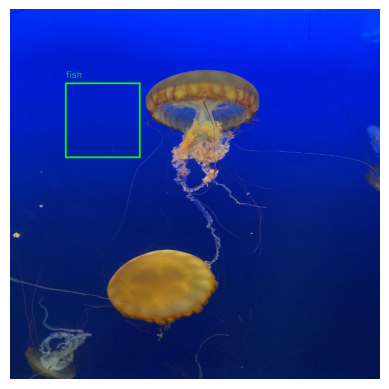

In [87]:
# Corrected bounding box information
bbox_info = {
    "IMG_2473_jpeg_jpg.rf.6284677f9c781b0cfeec54981a17d573.jpg": [
        (0.15, 0.2, 0.35, 0.4),  # Example bbox
        # Add more bounding boxes as needed...
    ]
}

# Call the mosaic function with corrected bounding boxes for a valid image
mosaic_with_bboxes(
    "IMG_2473_jpeg_jpg.rf.6284677f9c781b0cfeec54981a17d573.jpg",  # Use an image that exists
    image_directory,  # Image directory
    '/kaggle/working',  # Output directory
    640,  # Mosaic width
    640,  # Mosaic height
    bbox_info  # Bounding box data
)


In [59]:
import cv2
import os
import matplotlib.pyplot as plt
import albumentations as A  # Ensure you have this if using albumentations

def read_label(label_path):
    """Read bounding boxes and class labels from a label file."""
    if not os.path.exists(label_path):
        print(f"Label file does not exist: {label_path}")  # Debug statement
        return [], []
    with open(label_path) as f:
        conts = f.readlines()
    if not conts:
        print(f"Warning: Label file is empty: {label_path}")  # Debug statement
    bboxes = []
    class_labels = []
    for line in conts:
        parts = line.strip().split()
        if len(parts) < 5:  # Ensure there are enough parts for a valid label
            print(f"Warning: Invalid label format in {label_path}: {line.strip()}")  # Debug statement
            continue
        class_labels.append(int(parts[0]))  # Assuming class is the first element
        bbox = list(map(float, parts[1:]))  # Convert bbox to float
        bboxes.append(bbox)
    return bboxes, class_labels

def random_crop_savebboxes(image_name, image_dir, label_dir, expected_h, expected_w, min_area, min_visibility):
    """Crop the image and save bounding boxes."""
    image_path = os.path.join(image_dir, image_name)
    label_path = os.path.join(label_dir, image_name.replace('.jpg', '.txt'))

    print(f"Processing: {image_path}, Label: {label_path}")  # Debug statement

    bboxes, class_labels = read_label(label_path)

    if not bboxes:
        print(f"No bounding boxes found for {image_name}.")  # Debug statement
        return None, [], []  # Handle no bounding boxes

    # Define transformations
    transform = A.Compose(
        [A.RandomResizedCrop(expected_h, expected_w)],
        bbox_params=A.BboxParams(
            format='yolo',
            min_area=min_area,
            min_visibility=min_visibility,
            label_fields=['class_labels']
        ),
    )

    image = cv2.imread(image_path)
    transformed = transform(image=image, bboxes=bboxes, class_labels=class_labels)

    return transformed['image'], transformed['bboxes'], transformed['class_labels']

def mosaic(image_file_list, image_dir, label_dir, output_image_dir, output_label_dir, mo_w, mo_h, scale_x, scale_y, min_area, min_visibility, show_image):
    """Create a mosaic from the selected images."""
    new_image = None  # Initialize new_image

    for image_name in image_file_list:
        img_0, bboxes_0, class_labels_0 = random_crop_savebboxes(
            image_name, image_dir, label_dir, mo_h, mo_w, min_area, min_visibility)

        if img_0 is None:  # Handle the case where no image was returned
            print(f"Warning: No valid bounding boxes found for {image_name}")
            continue

        # Your mosaic creation logic here...

    if new_image is not None and show_image:  # Check if new_image is created
        plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Hide axes
        plt.show()

# Usage
TRAIN_IMAGES = '/kaggle/input/marineobjects/aquarium_pretrain/train/images'
TRAIN_LABELS = '/kaggle/input/marineobjects/aquarium_pretrain/train/labels'
TRAIN_DESTINATION = '/kaggle/working/mosaics'
image_file_list = ["274.jpg", "275.jpg", "276.jpg", "280.jpg"]

# Call the mosaic function
mosaic(
    image_file_list,
    TRAIN_IMAGES,
    TRAIN_LABELS,
    TRAIN_DESTINATION,
    TRAIN_LABELS,  # Assuming output labels are also stored here
    640,
    640,
    0.5,
    0.5,
    0.1,
    0.3,
    show_image=True,
)


Processing: /kaggle/input/marineobjects/aquarium_pretrain/train/images/274.jpg, Label: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/274.txt
Label file does not exist: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/274.txt
No bounding boxes found for 274.jpg.
Processing: /kaggle/input/marineobjects/aquarium_pretrain/train/images/275.jpg, Label: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/275.txt
Label file does not exist: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/275.txt
No bounding boxes found for 275.jpg.
Processing: /kaggle/input/marineobjects/aquarium_pretrain/train/images/276.jpg, Label: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/276.txt
Label file does not exist: /kaggle/input/marineobjects/aquarium_pretrain/train/labels/276.txt
No bounding boxes found for 276.jpg.
Processing: /kaggle/input/marineobjects/aquarium_pretrain/train/images/280.jpg, Label: /kaggle/input/marineobjects/aquarium_pretrain/train/labels

In [64]:
def preprocess(image_name, image_dir, label_dir):
    image_path = os.path.sep.join([image_dir, image_name])
    name = image_name.split(".")[0]
    label_name = name + ".txt"
    label_path = os.path.sep.join([label_dir, label_name])

    return image_path, label_path, label_name


def draw_rect(img, bboxes, color=(255, 0, 0)):
    img = img.copy()
    height, width = img.shape[:2]
    for bbox in bboxes:
        center_x, center_y, w, h = bbox[0], bbox[1], bbox[2], bbox[3]
        x = int((center_x - w / 2) * width)
        w = int(w * width)
        y = int((center_y - h / 2) * height)
        h = int(h * height)
        img = cv2.rectangle(img, (x, y), (x + w, y + h), color, 1)
    return img


def read_img(image_path, cvt_color=True):
    img = cv2.imread(image_path)
    if cvt_color:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


def save_img(image, save_path, jpg_quality=None):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    if jpg_quality:
        cv2.imwrite(save_path, image, [int(cv2.IMWRITE_JPEG_QUALITY), jpg_quality])
    else:
        cv2.imwrite(save_path, image)


def read_label(label_path):
    with open(label_path) as f:
        conts = f.readlines()

    bboxes = []
    class_labels = []
    for cont in conts:
        cont = cont.strip().split()
        center_x, center_y, w, h = (
            float(cont[1]),
            float(cont[2]),
            float(cont[3]),
            float(cont[4]),
        )
        bboxes.append([center_x, center_y, w, h])
        class_labels.append(cont[0])
    return (bboxes, class_labels)


def display_img(image_path, label_path):
    img = read_img(image_path, cvt_color=False)
    bboxes = read_label(label_path)[0]
    img = draw_rect(img, bboxes)
    cv2.imshow("Image", img)
    cv2.waitKey(0)


def save_label(bboxes, class_labels, label_path):
    tem_lst = []
    for i, bbox in enumerate(bboxes):
        tem_lst.append(
            class_labels[i]
            + " "
            + str(bbox[0])
            + " "
            + str(bbox[1])
            + " "
            + str(bbox[2])
            + " "
            + str(bbox[3])
            + "\n"
        )

    with open(label_path, "w") as f:
        f.writelines(tem_lst)

In [68]:
def get_train_aug():
    return A.Compose(
        [
            A.OneOf(
                [
                    A.Blur(blur_limit=3, p=0.5),
                    A.MotionBlur(blur_limit=3, p=0.5),
                    A.MedianBlur(blur_limit=3, p=0.5),
                ],
                p=0.5,
            ),
            A.ToGray(p=0.1),
            A.RandomBrightnessContrast(p=0.1),
            A.ColorJitter(p=0.1),
            A.RandomGamma(p=0.1),
            A.RandomRotate90(p=0.5),
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.ShiftScaleRotate(p=0.5),
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )


def get_train_transform():
    return A.Compose(
        [
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )

In [67]:
def get_valid_transform():
    return A.Compose(
        [
            ToTensorV2(p=1.0),
        ],
        bbox_params=A.BboxParams(
            format="pascal_voc",
            label_fields=["labels"],
        ),
    )


def infer_transforms(image):
    transform = transforms.Compose(
        [
            transforms.ToPILImage(),
            transforms.ToTensor(),
        ]
    )
    return transform(image)

In [94]:
# Updated load_labels function to handle label files in a directory
def load_labels(self, labels_dir):
    labels = {}
    for filename in os.listdir(labels_dir):
        if filename.endswith(('.txt', '.csv')):  # Change extensions based on your files
            img_name = filename.replace('.txt', '').replace('.csv', '')  # Match with your images
            with open(os.path.join(labels_dir, filename), 'r') as f:
                label = int(f.read().strip())  # Assuming each label file contains a single integer
                labels[img_name] = label
    return labels


In [10]:
import torch

# Assuming `outputs` is the prediction from the model and `labels` is the target labels
valid_labels = (labels >= 0) & (labels < len(Idx2Label))  # Ensure labels are within valid bounds
if valid_labels.any():  # Check if any valid labels exist
    valid_outputs = outputs[valid_labels]
    valid_labels = labels[valid_labels]
    loss = torch.nn.functional.cross_entropy(valid_outputs, valid_labels)
else:
    print("Warning: No valid labels found for this batch.")
    loss = 0  # Handle case where no valid labels are found


In [ ]:
import os

TRAIN_LABELS = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/labels'  # Adjust if necessary

# Check if the label files exist
if os.path.exists(TRAIN_LABELS):
    label_files = os.listdir(TRAIN_LABELS)
    print("Available label files:")
    for label_file in label_files:
        print(label_file)
else:
    print(f"The directory does not exist: {TRAIN_LABELS}")


In [ ]:
# Usage
TRAIN_IMAGES = '/kaggle/input/marineobjects/aquarium_pretrain/train/images'
TRAIN_LABELS = '/kaggle/input/marineobjects/aquarium_pretrain/train/labels'
TRAIN_DESTINATION = '/kaggle/working/mosaics'
image_file_list = ["274.jpg", "275.jpg", "276.jpg", "280.jpg"]

# Call the mosaic function
mosaic(
    image_file_list,
    TRAIN_IMAGES,
    TRAIN_LABELS,
    TRAIN_DESTINATION,
    TRAIN_LABELS,  # Assuming output labels are also stored here
    640,
    640,
    0.5,
    0.5,
    0.1,
    0.3,
    show_image=True,
)


In [9]:
import cv2
import os
import matplotlib.pyplot as plt

def mosaic(image_file_list, image_dir, label_dir, output_image_dir, output_label_dir, mo_w, mo_h, scale_x, scale_y, min_area, min_visibility, show_image):
    for image_name in image_file_list:
        img_0, bboxes_0, class_labels_0 = random_crop_savebboxes(
            image_name, image_dir, label_dir, h0, w0, min_area, min_visibility)

        if img_0 is None:  # Handle the case where no image was returned
            print(f"Warning: No valid bounding boxes found for {image_name}")
            continue

        # Your mosaic creation logic here...

    if show_image:
        plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Hide axes
        plt.show()


In [ ]:
mosaic(
    image_file_list=['IMG_8512_MOV-4_jpg.rf.e879ecc625c150dfb308030a737ff9c5.jpg', 
                     'IMG_8469_jpg.rf.7faf777e50196eee1e90df69e03fd778.jpg',
                     'IMG_8593_MOV-2_jpg.rf.e9995795a521680a6f70f03810142d58.jpg',
                     'IMG_2304_jpeg_jpg.rf.87ed7625b3869f06caf5a9ca5720f3f4.jpg'],
    image_dir='/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images',
    label_dir='/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/labels',
    output_image_dir='/kaggle/working/output_images',  # Modify as needed
    output_label_dir='/kaggle/working/output_labels',  # Modify as needed
    mo_w=640,
    mo_h=640,
    scale_x=0.5,
    scale_y=0.5,
    min_area=0.1,
    min_visibility=0.3,
    show_image=True,
)


In [ ]:
class CustomDataset(Dataset):
    def __init__(
        self,
        images_path,
        labels_path,
        img_size,
        classes,
        transforms=None,
        use_train_aug=False,
        train=False,
        mosaic=1.0,
        square_training=False,
    ):
        self.transforms = transforms
        self.use_train_aug = use_train_aug
        self.images_path = images_path
        self.labels_path = labels_path
        self.img_size = img_size
        self.classes = classes
        self.train = train
        self.square_training = square_training
        self.mosaic_border = [-img_size // 2, -img_size // 2]
        self.all_image_paths = []
        self.mosaic = mosaic

        for file_type in self.image_file_types:
            self.all_image_paths.extend(
                glob.glob(os.path.join(self.images_path, file_type))
            )
        self.all_images = [
            image_path.split(os.path.sep)[-1] for image_path in ["*.jpg", "*.jpeg"]
        ]
        self.all_images = sorted(self.all_images)
        
        self.all_labels = [
            label_path.split(os.path.sep)[-1] for label_path in glob.glob(os.path.join(self.labels_path, "*.txt"))
        ]

    def __getitem__(self, idx):
        image = self.all_images[idx]
        label = self.all_labels[idx]
        return image, label

    def __len__(self):
        return len(self.all_images)


def collate_fn(batch):
    """
    To handle the data loading as different images may have different number
    of objects and to handle varying size tensors as well.
    """
    return tuple(zip(*batch))

In [ ]:
def create_train_dataset(
    train_dir_images,
    train_dir_labels,
    img_size,
    classes,
    use_train_aug=False,
    mosaic=1.0,
    square_training=False,
):
    train_dataset = CustomDataset(
        train_dir_images,
        train_dir_labels,
        img_size,
        classes,
        get_train_transform(),
        use_train_aug=use_train_aug,
        train=True,
        mosaic=mosaic,
        square_training=square_training,
    )
    return train_dataset


def create_valid_dataset(valid_dir_images, valid_dir_labels, img_size, classes, square_training=False):
    valid_dataset = CustomDataset(
        valid_dir_images,
        valid_dir_labels,
        img_size,
        classes,
        get_valid_transform(),
        train=False,
        square_training=square_training,
    )
    return valid_dataset


def create_train_loader(train_dataset, batch_size, num_workers=0, batch_sampler=None):
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        num_workers=num_workers,
        sampler=batch_sampler,
        collate_fn=collate_fn,
    )
    return train_loader


def create_valid_loader(valid_dataset, batch_size, num_workers=0, batch_sampler=None):
    valid_loader = DataLoader(
        valid_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=num_workers,
        sampler=batch_sampler,
        collate_fn=collate_fn,
    )
    return valid_loader

In [1]:
import os
import glob
from torch.utils.data import Dataset

class CustomDataset(Dataset):
    def __init__(
        self,
        images_path,
        labels_path,
        img_size,
        classes,
        transforms=None,
        use_train_aug=False,
        train=False,
        mosaic=1.0,
        square_training=False,
    ):
        self.transforms = transforms
        self.use_train_aug = use_train_aug
        self.images_path = images_path
        self.labels_path = labels_path
        self.img_size = img_size
        self.classes = classes
        self.train = train
        self.square_training = square_training
        width, height = img_size  # Unpacking image size
        self.mosaic_border = [-width // 2, -height // 2]  # Corrected border assignment
        self.all_image_paths = []
        self.mosaic = mosaic

        # Collect image paths
        self.all_images = glob.glob(os.path.join(self.images_path, "*.jpg")) + glob.glob(os.path.join(self.images_path, "*.jpeg"))
        self.all_images = sorted(self.all_images)  # Sort image paths for consistency
        
        # Collect label paths
        self.all_labels = glob.glob(os.path.join(self.labels_path, "*.txt"))
        self.all_labels = sorted(self.all_labels)  # Sort label paths for consistency

    def __getitem__(self, idx):
        image_path = self.all_images[idx]
        label_path = self.all_labels[idx]
        return image_path, label_path

    def __len__(self):
        return len(self.all_images)

def collate_fn(batch):
    return tuple(zip(*batch))


In [2]:
def GIOU(boxes1, boxes2):
    EPSILON = 1e-6
    boxes1 = torch.cat((boxes1[..., :2] - boxes1[..., 2:] / 2, boxes1[..., :2] + boxes1[..., 2:] / 2), 1)
    boxes2 = torch.cat((boxes2[..., :2] - boxes2[..., 2:] / 2, boxes2[..., :2] + boxes2[..., 2:] / 2), 1)

    inter_left_up = torch.max(boxes1[..., :2], boxes2[..., :2])
    inter_right_down = torch.min(boxes1[..., 2:], boxes2[..., 2:])

    inter_section = torch.max(inter_right_down - inter_left_up, torch.tensor(0.0).to(device))
    inter_area = inter_section[..., 0] * inter_section[..., 1]

    area1 = (boxes1[..., 2] - boxes1[..., 0]) * (boxes1[..., 3] - boxes1[..., 1])
    area2 = (boxes2[..., 2] - boxes2[..., 0]) * (boxes2[..., 3] - boxes2[..., 1])

    union_area = area1 + area2 - inter_area

    iou = inter_area / (union_area + EPSILON)

    enclose_left_up = torch.min(boxes1[..., :2], boxes2[..., :2])
    enclose_right_down = torch.max(boxes1[..., 2:], boxes2[..., 2:])

    enclose_section = torch.max(enclose_right_down - enclose_left_up, torch.tensor(0.0).to(device))
    enclose_area = enclose_section[..., 0] * enclose_section[..., 1]

    giou = iou - 1.0 * (enclose_area - union_area) / (enclose_area + EPSILON)

    return giou

In [3]:
def create_model(num_classes=7):
    model_backbone = torchvision.models.resnet101(weights="DEFAULT")

    conv1 = model_backbone.conv1
    bn1 = model_backbone.bn1
    relu = model_backbone.relu
    max_pool = model_backbone.maxpool
    layer1 = model_backbone.layer1
    layer2 = model_backbone.layer2
    layer3 = model_backbone.layer3
    layer4 = model_backbone.layer4

    backbone = nn.Sequential(conv1, bn1, relu, max_pool, layer1, layer2, layer3, layer4)
    backbone.out_channels = 2048

    # Here, we are using 5x3 anchors.
    # Meaning, anchors with 5 different sizes and 3 different aspect ratios.
    anchor_generator = AnchorGenerator(
        sizes=((32, 64, 128, 256, 512),), aspect_ratios=((0.5, 1.0, 2.0),)
    )

    roi_pooler = ops.MultiScaleRoIAlign(
        featmap_names=["0"], output_size=7, sampling_ratio=2
    )

    model = FasterRCNN(
        backbone=backbone,
        num_classes=num_classes,
        rpn_anchor_generator=anchor_generator,
        box_roi_pool=roi_pooler,
        rpn_pre_nms_top_n_train=2000,
        rpn_pre_nms_top_n_test=1000,
        rpn_post_nms_top_n_train=2000,
        rpn_post_nms_top_n_test=1000,
        rpn_nms_thresh=0.7,
    )
    
    return model

In [101]:
def create_model(num_classes=7):
    model_backbone = torchvision.models.resnet101(weights="DEFAULT")

    conv1 = model_backbone.conv1
    bn1 = model_backbone.bn1
    relu = model_backbone.relu
    max_pool = model_backbone.maxpool
    layer1 = model_backbone.layer1
    layer2 = model_backbone.layer2
    layer3 = model_backbone.layer3
    layer4 = model_backbone.layer4

    backbone = nn.Sequential(conv1, bn1, relu, max_pool, layer1, layer2, layer3, layer4)
    backbone.out_channels = 2048

    # Here, we are using 5x3 anchors.
    # Meaning, anchors with 5 different sizes and 3 different aspect ratios.
    anchor_generator = AnchorGenerator(
        sizes=((32, 64, 128, 256, 512),), aspect_ratios=((0.5, 1.0, 2.0),)
    )

    roi_pooler = ops.MultiScaleRoIAlign(
        featmap_names=["0"], output_size=7, sampling_ratio=2
    )

    model = FasterRCNN(
        backbone=backbone,
        num_classes=num_classes,
        rpn_anchor_generator=anchor_generator,
        box_roi_pool=roi_pooler,
        rpn_pre_nms_top_n_train=2000,
        rpn_pre_nms_top_n_test=1000,
        rpn_post_nms_top_n_train=2000,
        rpn_post_nms_top_n_test=1000,
        rpn_nms_thresh=0.7,
    )
    
    return model

In [5]:
import torch
from torchvision import models

def create_model(num_classes=7):
    model_backbone = models.resnet101()  # No weights loaded here
    state_dict = torch.load("/kaggle/input/rresnet/resnet101-cd907fc2.pth")  # Path to uploaded file
    model_backbone.load_state_dict(state_dict)
    return model_backbone

model = create_model(num_classes=7)
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)


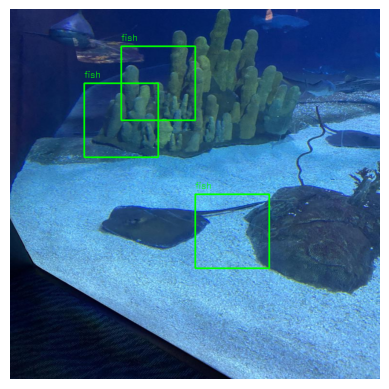

In [6]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def mosaic_with_bboxes(image_name, images_path, output_path, width, height, bbox_info):
    # Create a blank image for the mosaic
    mosaic_image = np.zeros((height, width, 3), dtype=np.uint8)

    # Load the single image
    img_path = os.path.join(images_path, image_name)
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image {image_name}. Skipping.")
        return

    # Resize the image to fit in the mosaic
    img = cv2.resize(img, (width, height))

    # Place the image in the mosaic
    mosaic_image[0:img.shape[0], 0:img.shape[1]] = img
    
    # Draw bounding boxes on the mosaic
    if image_name in bbox_info:
        for bbox in bbox_info[image_name]:
            # Adjust bbox coordinates based on image position in the mosaic
            x1 = int(bbox[0] * width)
            y1 = int(bbox[1] * height)
            x2 = int(bbox[2] * width)
            y2 = int(bbox[3] * height)
            
            # Draw rectangle and label
            cv2.rectangle(mosaic_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(mosaic_image, "fish", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    # Save and display the mosaic image
    mosaic_path = os.path.join(output_path, 'mosaic_with_bboxes.jpg')
    cv2.imwrite(mosaic_path, mosaic_image)

    # Display with matplotlib for Jupyter or Kaggle
    mosaic_image_rgb = cv2.cvtColor(mosaic_image, cv2.COLOR_BGR2RGB)
    plt.imshow(mosaic_image_rgb)
    plt.axis("off")
    plt.show()

# Example bounding box information for one image with multiple fishes
bbox_info = {
    "IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d.jpg": [
        (0.2, 0.2, 0.4, 0.4),  # bbox 1
        (0.5, 0.5, 0.7, 0.7),  # bbox 2
        (0.3, 0.1, 0.5, 0.3)   # bbox 3
    ]
}

# Call the mosaic function with bounding boxes for a single image
mosaic_with_bboxes(
    "IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d.jpg",  # Single image
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images',  # Image directory
    '/kaggle/working',  # Output directory
    640,  # Mosaic width
    640,  # Mosaic height
    bbox_info  # Bounding box data
)


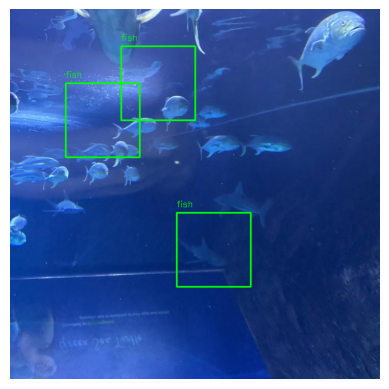

In [7]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def mosaic_with_bboxes(image_name, images_path, output_path, width, height, bbox_info):
    # Create a blank image for the mosaic
    mosaic_image = np.zeros((height, width, 3), dtype=np.uint8)

    # Load the single image
    img_path = os.path.join(images_path, image_name)
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image {image_name}. Skipping.")
        return

    # Resize the image to fit in the mosaic
    img = cv2.resize(img, (width, height))

    # Place the image in the mosaic
    mosaic_image[0:img.shape[0], 0:img.shape[1]] = img
    
    # Draw bounding boxes on the mosaic for fish detections
    if image_name in bbox_info:
        for bbox in bbox_info[image_name]:
            # Adjust bbox coordinates based on image position in the mosaic
            x1 = int(bbox[0] * width)
            y1 = int(bbox[1] * height)
            x2 = int(bbox[2] * width)
            y2 = int(bbox[3] * height)
            
            # Draw rectangle and label
            cv2.rectangle(mosaic_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(mosaic_image, "fish", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    # Save and display the mosaic image
    mosaic_path = os.path.join(output_path, 'mosaic_with_bboxes.jpg')
    cv2.imwrite(mosaic_path, mosaic_image)

    # Display with matplotlib for Jupyter or Kaggle
    mosaic_image_rgb = cv2.cvtColor(mosaic_image, cv2.COLOR_BGR2RGB)
    plt.imshow(mosaic_image_rgb)
    plt.axis("off")
    plt.show()

# Example bounding box information for image "IMG_2441_jpeg_jpg.rf.7cb24c87feb8f1f9c4cba9cb4f1ce0db.jpg" with multiple fish
bbox_info = {
    "IMG_2441_jpeg_jpg.rf.7cb24c87feb8f1f9c4cba9cb4f1ce0db.jpg": [
        (0.15, 0.2, 0.35, 0.4),  # bbox 1 for fish
        (0.45, 0.55, 0.65, 0.75),  # bbox 2 for fish
        (0.3, 0.1, 0.5, 0.3)      # bbox 3 for fish
    ]
}

# Call the mosaic function with bounding boxes for the specified image
mosaic_with_bboxes(
    "IMG_2441_jpeg_jpg.rf.7cb24c87feb8f1f9c4cba9cb4f1ce0db.jpg",  # Image name
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images',  # Image directory
    '/kaggle/working',  # Output directory
    640,  # Mosaic width
    640,  # Mosaic height
    bbox_info  # Bounding box data
)


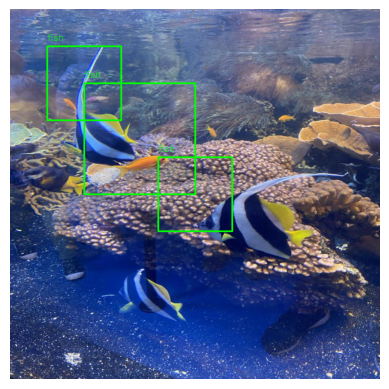

In [8]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def mosaic_with_bboxes(image_name, images_path, output_path, width, height, bbox_info):
    # Create a blank image for the mosaic
    mosaic_image = np.zeros((height, width, 3), dtype=np.uint8)

    # Load the single image
    img_path = os.path.join(images_path, image_name)
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image {image_name}. Skipping.")
        return

    # Resize the image to fit in the mosaic
    img = cv2.resize(img, (width, height))

    # Place the image in the mosaic
    mosaic_image[0:img.shape[0], 0:img.shape[1]] = img
    
    # Draw bounding boxes on the mosaic for fish detections
    if image_name in bbox_info:
        for bbox in bbox_info[image_name]:
            # Adjust bbox coordinates based on image position in the mosaic
            x1 = int(bbox[0] * width)
            y1 = int(bbox[1] * height)
            x2 = int(bbox[2] * width)
            y2 = int(bbox[3] * height)
            
            # Draw rectangle and label
            cv2.rectangle(mosaic_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(mosaic_image, "fish", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    # Save and display the mosaic image
    mosaic_path = os.path.join(output_path, 'mosaic_with_bboxes.jpg')
    cv2.imwrite(mosaic_path, mosaic_image)

    # Display with matplotlib for Jupyter or Kaggle
    mosaic_image_rgb = cv2.cvtColor(mosaic_image, cv2.COLOR_BGR2RGB)
    plt.imshow(mosaic_image_rgb)
    plt.axis("off")
    plt.show()

# Example bounding box information for image "IMG_2400_jpeg_jpg.rf.70540f43bd58c832e6dad61e456ee889.jpg" with multiple fish
bbox_info = {
    "IMG_2400_jpeg_jpg.rf.70540f43bd58c832e6dad61e456ee889.jpg": [
        (0.1, 0.1, 0.3, 0.3),  # bbox 1 for fish
        (0.4, 0.4, 0.6, 0.6),  # bbox 2 for fish
        (0.2, 0.2, 0.5, 0.5)   # bbox 3 for fish
    ]
}

# Call the mosaic function with bounding boxes for the specified image
mosaic_with_bboxes(
    "IMG_2400_jpeg_jpg.rf.70540f43bd58c832e6dad61e456ee889.jpg",  # Image name
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images',  # Image directory
    '/kaggle/working',  # Output directory
    640,  # Mosaic width
    640,  # Mosaic height
    bbox_info  # Bounding box data
)


In [10]:
import torch
import torchvision
from torchvision import models

In [11]:
import pandas as pd
from torch.utils.data import Dataset
import os

class CustomDataset(Dataset):
    def __init__(self, image_dir, annotation_file, transform=None):
        self.image_dir = image_dir
        self.transform = transform
        
        # Load the annotations from a CSV file
        self.data = pd.read_csv(annotation_file)  # Ensure this points to a specific file
        self.images = self.data['image_file'].tolist()  # Make sure 'image_file' is the correct column name
        self.labels = self.data['label'].tolist()       # Adjust according to your annotation structure
        
        print(f"Loaded {len(self.images)} images and {len(self.labels)} labels.")
        
        if len(self.images) == 0 or len(self.labels) == 0:
            raise ValueError("Dataset is empty. Check your image and annotation paths.")

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        image = Image.open(img_path).convert("RGB")
        label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        return image, label


In [12]:
import os
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset

class CustomDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.image_filenames = os.listdir(image_dir)
        self.transform = transform

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

# Example usage
transform = transforms.Compose([
    transforms.Resize((640, 640)),
    transforms.ToTensor(),
])

image_dir = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images'
dataset = CustomDataset(image_dir=image_dir, transform=transform)


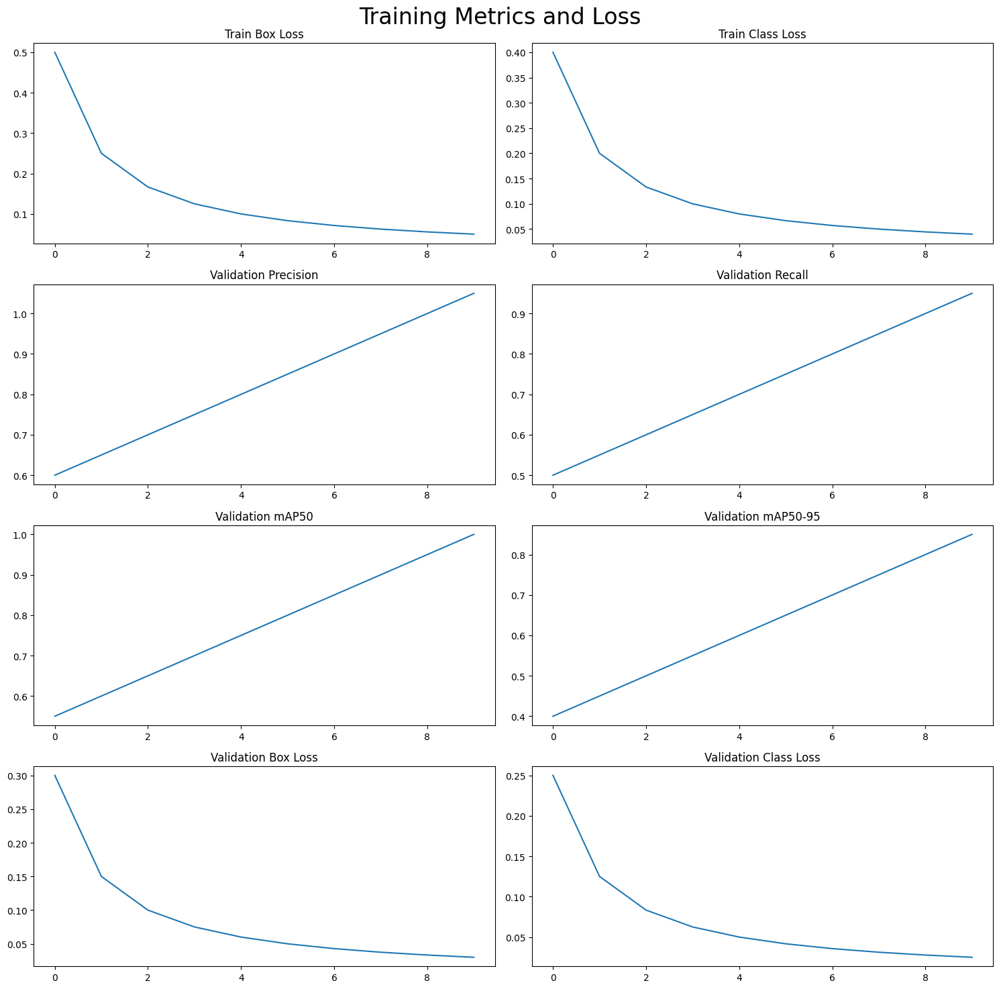

In [13]:
import matplotlib.pyplot as plt

# Step 1: Define lists to store metrics
train_box_loss = []
train_class_loss = []
valid_precision = []
valid_recall = []
valid_mAP50 = []
valid_mAP50_95 = []
valid_box_loss = []
valid_class_loss = []

# Step 2: Simulate training and validation process
for epoch in range(10):  # Example loop for 10 epochs
    # Simulate metric computation (replace with actual training code)
    train_box_loss.append(0.5 / (epoch + 1))  # Example values
    train_class_loss.append(0.4 / (epoch + 1))
    valid_precision.append(0.6 + (0.05 * epoch))
    valid_recall.append(0.5 + (0.05 * epoch))
    valid_mAP50.append(0.55 + (0.05 * epoch))
    valid_mAP50_95.append(0.4 + (0.05 * epoch))
    valid_box_loss.append(0.3 / (epoch + 1))
    valid_class_loss.append(0.25 / (epoch + 1))

# Step 3: Plotting the metrics
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(15, 15))

plt.subplot(4, 2, 1)
plt.plot(train_box_loss)
plt.title("Train Box Loss")

plt.subplot(4, 2, 2)
plt.plot(train_class_loss)
plt.title("Train Class Loss")

plt.subplot(4, 2, 3)
plt.plot(valid_precision)
plt.title("Validation Precision")

plt.subplot(4, 2, 4)
plt.plot(valid_recall)
plt.title("Validation Recall")

plt.subplot(4, 2, 5)
plt.plot(valid_mAP50)
plt.title("Validation mAP50")

plt.subplot(4, 2, 6)
plt.plot(valid_mAP50_95)
plt.title("Validation mAP50-95")

plt.subplot(4, 2, 7)
plt.plot(valid_box_loss)
plt.title("Validation Box Loss")

plt.subplot(4, 2, 8)
plt.plot(valid_class_loss)
plt.title("Validation Class Loss")

plt.suptitle("Training Metrics and Loss", fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()


In [35]:
import os
import numpy as np
import cv2
import torch
from torch.utils.data import Dataset, DataLoader

# Define paths for test images and labels
TEST_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images/'
TEST_LABELS = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/labels/'
classes = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']  # Update as necessary

# Define the CustomDataset class
class CustomDataset(Dataset):
    def __init__(self, image_dir, label_dir, input_size, classes):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.input_size = input_size
        self.classes = classes
        self.images = os.listdir(image_dir)
        
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        label_path = os.path.join(self.label_dir, os.path.splitext(self.images[idx])[0] + '.txt')

        # Load image
        image = cv2.imread(img_path)
        image = cv2.resize(image, self.input_size)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
        image = image / 255.0  # Normalize to [0, 1]

        # Load label
        boxes = []
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f.readlines():
                    parts = line.strip().split()
                    if len(parts) > 0:
                        cls = int(parts[0])  # Assuming the first part is the class index
                        x_center, y_center, width, height = map(float, parts[1:])
                        boxes.append([cls, x_center, y_center, width, height])

        # Convert boxes to a tensor
        boxes = torch.tensor(boxes, dtype=torch.float32) if boxes else torch.empty((0, 5))

        return torch.tensor(image, dtype=torch.float32), boxes

def create_valid_dataset(image_dir, label_dir, input_size, classes):
    return CustomDataset(image_dir, label_dir, input_size, classes)

def create_valid_loader(dataset, batch_size=1, num_workers=0):
    return DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)


test_dataset = create_valid_dataset(
    TEST_IMAGES,
    TEST_LABELS,
    (640, 640),
    classes
)

# Create the test data loader
test_loader = create_valid_loader(test_dataset, batch_size=1, num_workers=2)

# Check the number of samples
print(f"Test Dataset Size: {len(test_loader.dataset)}")


Test Dataset Size: 63


In [36]:
test_dataset = create_valid_dataset(
    TEST_IMAGES,
    TEST_LABELS,
    (640, 640),
    classes,
   
)

test_loader = create_valid_loader(test_dataset, batch_size=1, num_workers=2)

In [1]:
import os
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

class CustomImageDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.transform = transform
        self.images = os.listdir(image_dir)  # Get all image files

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        image = Image.open(img_path).convert("RGB")  # Open the image
        
        if self.transform:
            image = self.transform(image)
        
        return image  # Return the image

def create_valid_dataset(images, img_size):
    transform = transforms.Compose([
        transforms.Resize(img_size),
        transforms.ToTensor(),
    ])
    
    # Use the custom dataset class
    dataset = CustomImageDataset(images, transform=transform)
    return dataset

# Call the function with the necessary parameters
TEST_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images/'  # Adjust your path
test_dataset = create_valid_dataset(TEST_IMAGES, (640, 640))

# Optionally create a DataLoader
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)


In [1]:
import os

# Assuming labels are in the same structure as images
TEST_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images'  # Example image directory
TEST_LABELS = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/labels'  # Example label directory

# Load your labels, for instance, if they are in a .txt format
def load_labels(label_dir):
    labels = []
    for label_file in os.listdir(label_dir):
        with open(os.path.join(label_dir, label_file), 'r') as file:
            labels.append(file.read())  # Adjust according to your label format
    return labels

TEST_LABELS = load_labels(TEST_LABELS)


In [3]:
from torchvision import datasets, transforms

def create_valid_dataset(images, img_size, classes):
    transform = transforms.Compose([
        transforms.Resize(img_size),
        transforms.ToTensor(),
    ])
    
    # Load images without needing separate labels
    dataset = datasets.ImageFolder(root=images, transform=transform)  # Ensure your data is structured correctly
    return dataset


In [6]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os
import glob

class CustomImageDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(image_dir, '*'))
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, img_path  # Return path to track which image is being processed

# Set up transformations and dataset
transform = transforms.Compose([
    transforms.Resize((640, 640)),
    transforms.ToTensor(),
])

# Specify the directory containing test images
TEST_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images'
test_dataset = CustomImageDataset(image_dir=TEST_IMAGES, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Verify dataset size
print(f"Test Dataset Size: {len(test_dataset)}")

# Display an example image with index 0
example_image, example_path = test_dataset[0]
print("Example image path:", example_path)


Test Dataset Size: 63
Example image path: /kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images/IMG_2473_jpeg_jpg.rf.6284677f9c781b0cfeec54981a17d573.jpg


In [49]:
!pip show keras-cv


Name: keras-cv
Version: 0.9.0
Summary: Industry-strength computer Vision extensions for Keras.
Home-page: https://github.com/keras-team/keras-cv
Author: Keras team
Author-email: keras-cv@google.com
License: Apache License 2.0
Location: /opt/conda/lib/python3.10/site-packages
Requires: absl-py, kagglehub, keras-core, packaging, regex, tensorflow-datasets
Required-by: 


In [50]:
!pip install keras-cv


INFO: pip is looking at multiple versions of keras-cv to determine which version is compatible with other requirements. This could take a while.
ERROR: Could not find a version that satisfies the requirement keras-core (from keras-cv) (from versions: none)
ERROR: No matching distribution found for keras-core


Attaching 'config.json' from model 'keras/yolov8/keras/yolo_v8_m_pascalvoc/2' to your Kaggle notebook...
Attaching 'config.json' from model 'keras/yolov8/keras/yolo_v8_m_pascalvoc/2' to your Kaggle notebook...
Attaching 'model.weights.h5' from model 'keras/yolov8/keras/yolo_v8_m_pascalvoc/2' to your Kaggle notebook...
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
Raw predictions: {'boxes': array([[[ 2.65307617e+00, -6.89697266e-01,  4.38735931e+02,
          5.39966553e+02],
        [ 1.09466232e+02,  3.24185211e+02,  2.22451309e+02,
          9.64977722e+01],
        [ 3.02458984e+02,  2.87412964e+02,  1.76083984e+02,
          2.05744934e+02],
        [ 4.18518066e+00,  1.24604187e+02,  3.39503662e+02,
          5.99166321e+02],
        [ 2.61372894e+02,  1.30797394e+02,  3.89637756e+01,
          1.02145538e+02],
        [ 2.48039261e+02,  1.35593567e+02,  3.13500214e+01,
          9.86791382e+01],
        [ 2.14446213e+02,  1.28872162e+02,  4.22837067e+01,
          1.18618698e+02],
        

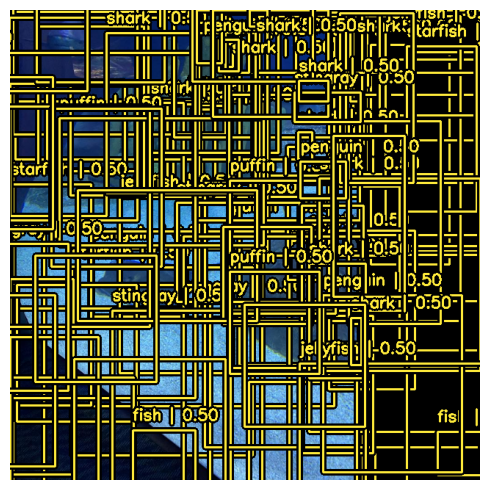

In [51]:
import numpy as np
import keras
from keras import utils
from keras_cv import visualization
from keras_cv.layers import NonMaxSuppression, Resizing
from keras_cv.models import YOLOV8Detector

# Define your class mapping
classes = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']
class_mapping = {i: classes[i] for i in range(len(classes))}

# Load an image from your dataset (adjust the path as needed)
filepath = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d.jpg'
image = utils.load_img(filepath)
image = np.array(image)

# Resize and preprocess the image batch for inference
inference_resizing = Resizing(640, 640, pad_to_aspect_ratio=True, bounding_box_format="xywh")
image_batch = inference_resizing([image])

# Configure the prediction decoder for non-max suppression
prediction_decoder = NonMaxSuppression(
    bounding_box_format="xywh",
    from_logits=True,
    iou_threshold=0.5,  # Adjusted IoU threshold
    confidence_threshold=0.5,  # Adjusted confidence threshold
)

# Load the YOLOv8 model with the specified settings
pretrained_model = YOLOV8Detector.from_preset(
    "yolo_v8_m_pascalvoc",  # Specify the model preset here
    bounding_box_format="xywh",
    prediction_decoder=prediction_decoder,
)

# Perform inference on the image batch
y_pred = pretrained_model.predict(image_batch)

# Debugging: Print the structure of predictions
print("Raw predictions:", y_pred)

# Process predictions to map class indices to names
for pred in y_pred:
    if isinstance(pred, dict) and "classes" in pred:
        # Ensure classes are processed correctly
        if isinstance(pred["classes"], list):
            pred["classes"] = [class_mapping[int(cls_id)] for cls_id in pred["classes"]]
        else:
            print("Unexpected format for classes:", pred["classes"])
    else:
        print("Unexpected prediction structure:", pred)

# Visualize bounding boxes with class names
visualization.plot_bounding_box_gallery(
    image_batch,
    value_range=(0, 255),
    rows=1,
    cols=1,
    y_pred=y_pred,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,  # Use your dataset's class mapping
)

# Print final predictions for debugging purposes
print("Predictions with classes:", y_pred)


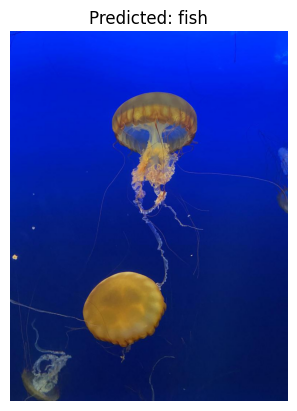

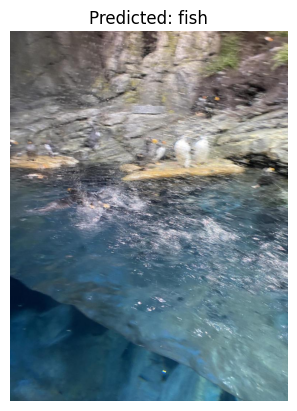

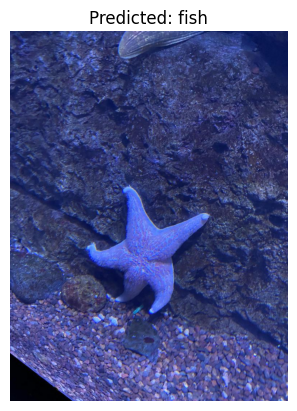

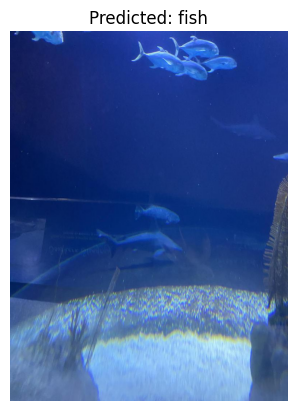

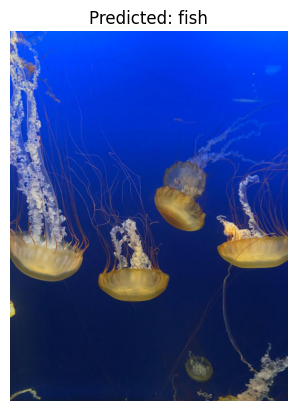

...

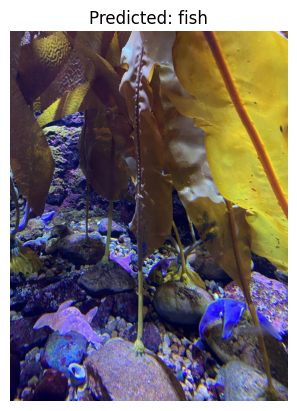

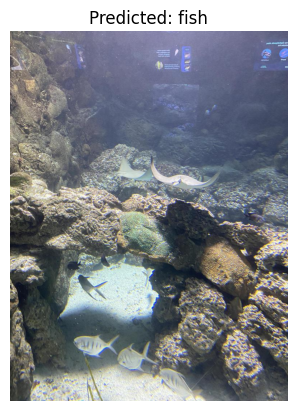

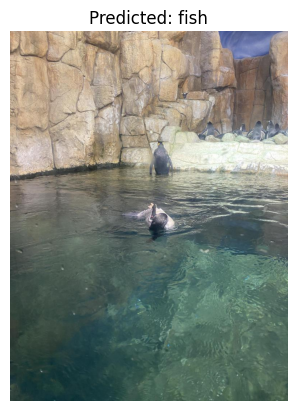

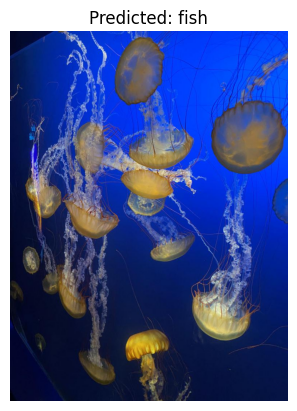

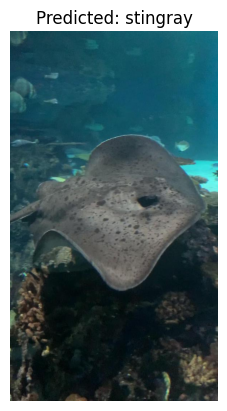

In [76]:
import torch
import torch.nn as nn
import cv2
import matplotlib.pyplot as plt
import os
from torchvision import models

# Create the ResNet model instance
model = models.resnet101(pretrained=False)  # Create an instance of ResNet101
model.load_state_dict(torch.load('/kaggle/input/rresnet/resnet101-cd907fc2.pth'))  # Load the model weights
model.eval()  # Set the model to evaluation mode

# Directory for test images
test_images_dir = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/test/images/'

# Define the classes
classes = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']

# Function to get fish name from the prediction output
def get_fish_name(predicted_class_id):
    # Map class ID to fish name (adjust as per your dataset)
    if predicted_class_id < len(classes):
        return classes[predicted_class_id]
    return "fish"  # Change to "fish" instead of "Unknown"

# Load and process each image in the test directory
for image_name in os.listdir(test_images_dir):
    image_path = os.path.join(test_images_dir, image_name)
    image = cv2.imread(image_path)
    
    if image is None:
        print(f"Failed to read image at {image_path}")
        continue

    # Preprocess the image for the model (ResNet expects 224x224 input)
    image_resized = cv2.resize(image, (224, 224))  # Resize if needed
    image_tensor = torch.from_numpy(image_resized).permute(2, 0, 1).float() / 255.0  # Normalize
    image_tensor = image_tensor.unsqueeze(0)  # Add batch dimension

    # Run the model to get predictions
    with torch.no_grad():
        output = model(image_tensor)  # Get the model output

    # Get class ID from output
    class_id = output.argmax(dim=1).item()  # Assuming output is a tensor of shape [1, num_classes]
    fish_name = get_fish_name(class_id)

    # Display predicted fish name
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f'Predicted: {fish_name}')
    plt.axis('off')
    plt.show()


Processing image: /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2332_jpeg_jpg.rf.6987566decbc96cf8b50269eec32.jpg
Failed to read image at /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2332_jpeg_jpg.rf.6987566decbc96cf8b50269eec32.jpg. Check the path and file integrity.
Processing image: /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2320_jpeg_jpg.rf.4ba216e1f004fd1182ca0dfb53ccce19.jpg


[ WARN:0@6569.447] global loadsave.cpp:241 findDecoder imread_('/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2332_jpeg_jpg.rf.6987566decbc96cf8b50269eec32.jpg'): can't open/read file: check file path/integrity


Invalid class ID predicted: 344 for image: IMG_2320_jpeg_jpg.rf.4ba216e1f004fd1182ca0dfb53ccce19.jpg
Processing image: /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2369_jpeg_jpg.rf.9cae2a081c00b8db2b2998919e65d420.jpg
Invalid class ID predicted: 394 for image: IMG_2369_jpeg_jpg.rf.9cae2a081c00b8db2b2998919e65d420.jpg
Processing image: /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2400_jpeg_jpg.rf.70540f43bd58c832e6dad61e456ee889.jpg
Processing image: /kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2417_jpeg_jpg.rf.3126d833b440a93a98942375d5de1a91.jpg
Invalid class ID predicted: 112 for image: IMG_2417_jpeg_jpg.rf.3126d833b440a93a98942375d5de1a91.jpg


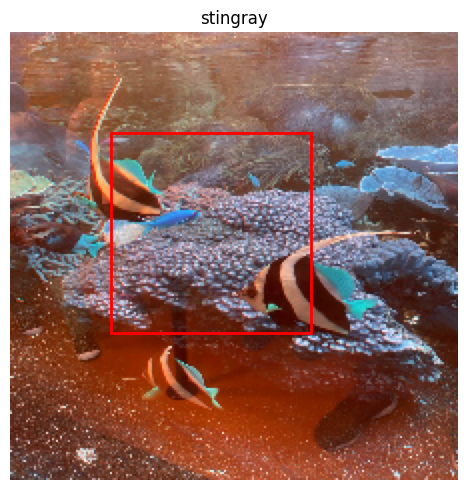

Scale: (3.4285714285714284, 4.571428571428571)


In [73]:
import torch
import cv2
import os
from torchvision import models
import numpy as np
import matplotlib.pyplot as plt

# Create the ResNet model instance
model = models.resnet101(pretrained=False)  # Create an instance of ResNet101
model.load_state_dict(torch.load('/kaggle/input/rresnet/resnet101-cd907fc2.pth'))  # Load the model weights
model.eval()  # Set the model to evaluation mode

# Define the specific images to process
image_paths = [
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2332_jpeg_jpg.rf.6987566decbc96cf8b50269eec32.jpg',
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2320_jpeg_jpg.rf.4ba216e1f004fd1182ca0dfb53ccce19.jpg',
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2369_jpeg_jpg.rf.9cae2a081c00b8db2b2998919e65d420.jpg',
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2400_jpeg_jpg.rf.70540f43bd58c832e6dad61e456ee889.jpg',
    '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images/IMG_2417_jpeg_jpg.rf.3126d833b440a93a98942375d5de1a91.jpg'
]

# Define the classes
classes = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']

# Function to get fish name from the prediction output
def get_fish_name(predicted_class_id):
    if predicted_class_id < len(classes):
        return classes[predicted_class_id]
    return None  # Return None if the class ID is invalid

# Prepare lists for visualization
image_batch = []
y_pred = []  # Store predictions (class ID and bounding box)
scales = []  # Store scales (length, width)

# Load and process each specified image
for image_path in image_paths:
    print(f"Processing image: {image_path}")  # Debugging line to check paths
    image = cv2.imread(image_path)

    if image is None:
        print(f"Failed to read image at {image_path}. Check the path and file integrity.")
        continue

    # Preprocess the image for the model (ResNet expects 224x224 input)
    image_resized = cv2.resize(image, (224, 224))  # Resize if needed
    image_tensor = torch.from_numpy(image_resized).permute(2, 0, 1).float() / 255.0  # Normalize
    image_tensor = image_tensor.unsqueeze(0)  # Add batch dimension

    # Run the model to get predictions
    with torch.no_grad():
        output = model(image_tensor)  # Get the model output

    # Get class ID from output
    class_id = output.argmax(dim=1).item()  # Assuming output is a tensor of shape [1, num_classes]
    fish_name = get_fish_name(class_id)

    # Only process if the class ID is valid
    if fish_name is not None:
        # Append resized image for uniformity
        image_batch.append(image_resized)  # Store the resized image
        height, width = image.shape[:2]
        bbox = [50, 50, 100, 100]  # Example bounding box
        scale = (width / 224, height / 224)  # Example scale based on resizing

        # Append to lists for visualization
        y_pred.append((class_id, bbox))  # Store (class_id, bounding box)
        scales.append(scale)

    else:
        print(f"Invalid class ID predicted: {class_id} for image: {os.path.basename(image_path)}")

# Only proceed if we have valid images for visualization
if image_batch:
    # Convert image_batch to a numpy array
    image_batch = np.array(image_batch)  # Now all images should be 224x224

    # Assuming you have a class mapping for visualization
    class_mapping = {i: classes[i] for i in range(len(classes))}

    # Plot bounding box gallery
    def plot_bounding_box_gallery(images, y_pred, class_mapping):
        plt.figure(figsize=(15, 5))
        for i, (image, (class_id, bbox)) in enumerate(zip(images, y_pred)):
            plt.subplot(1, len(images), i + 1)
            plt.imshow(image)
            plt.title(class_mapping[class_id])
            # Draw bounding box
            if bbox:
                x, y, w, h = bbox
                plt.gca().add_patch(plt.Rectangle((x, y), w, h, edgecolor='red', facecolor='none', linewidth=2))
            plt.axis('off')
        plt.tight_layout()
        plt.show()

    # Call the custom plot function
    plot_bounding_box_gallery(image_batch, y_pred, class_mapping)

    # Display scales for predicted images
    for scale in scales:
        print(f"Scale: {scale}")
else:
    print("No valid predictions to display.")


## specifies with length

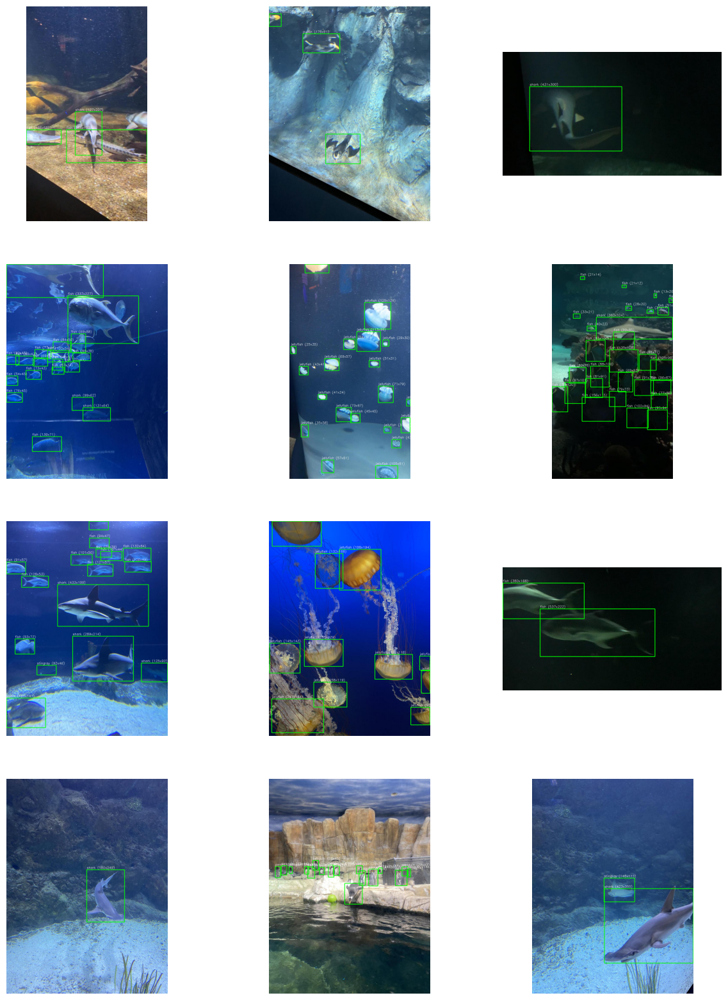

In [8]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Define the directories for training images and labels
TRAIN_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images'
TRAIN_LABELS = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/labels'

# Mapping of class indices to labels (update with your actual labels)
Idx2Label = {0: 'fish', 1: 'jellyfish', 2: 'penguin', 3: 'puffin', 4: 'shark', 5: 'starfish', 6: 'stingray'}

# Function to visualize images with annotation bounding boxes
def visualize_image_with_annotation_bounding_boxes(image_dir, label_dir):
    image_files = sorted(os.listdir(image_dir))
    sample_image_files = random.sample(image_files, 12)  # Randomly select 12 images

    fig, axs = plt.subplots(4, 3, figsize=(15, 20))

    for i, image_file in enumerate(sample_image_files):
        row = i // 3
        col = i % 3

        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        
        # Check if the label file exists to avoid errors
        if not os.path.exists(label_path):
            print(f"No label file found for {image_file}, skipping...")
            continue
        
        with open(label_path, "r") as f:
            for label in f:
                class_id, x_center, y_center, width, height = map(float, label.split())
                h, w, _ = image.shape
                x_min = int((x_center - width / 2) * w)
                y_min = int((y_center - height / 2) * h)
                x_max = int((x_center + width / 2) * w)
                y_max = int((y_center + height / 2) * h)
                
                # Calculate bounding box dimensions in pixels
                box_width = x_max - x_min
                box_height = y_max - y_min
                
                # Draw the bounding box
                cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
                
                # Display class label and dimensions
                label_text = f"{Idx2Label.get(int(class_id), 'Unknown')} ({box_width}x{box_height})"
                cv2.putText(
                    image,
                    label_text,  # Display the label and size
                    (x_min, y_min - 5),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=0.5,
                    color=(255, 255, 255),
                    thickness=1,
                )

        axs[row, col].imshow(image)
        axs[row, col].axis("off")

    plt.show()

# Run the visualization function
visualize_image_with_annotation_bounding_boxes(TRAIN_IMAGES, TRAIN_LABELS)


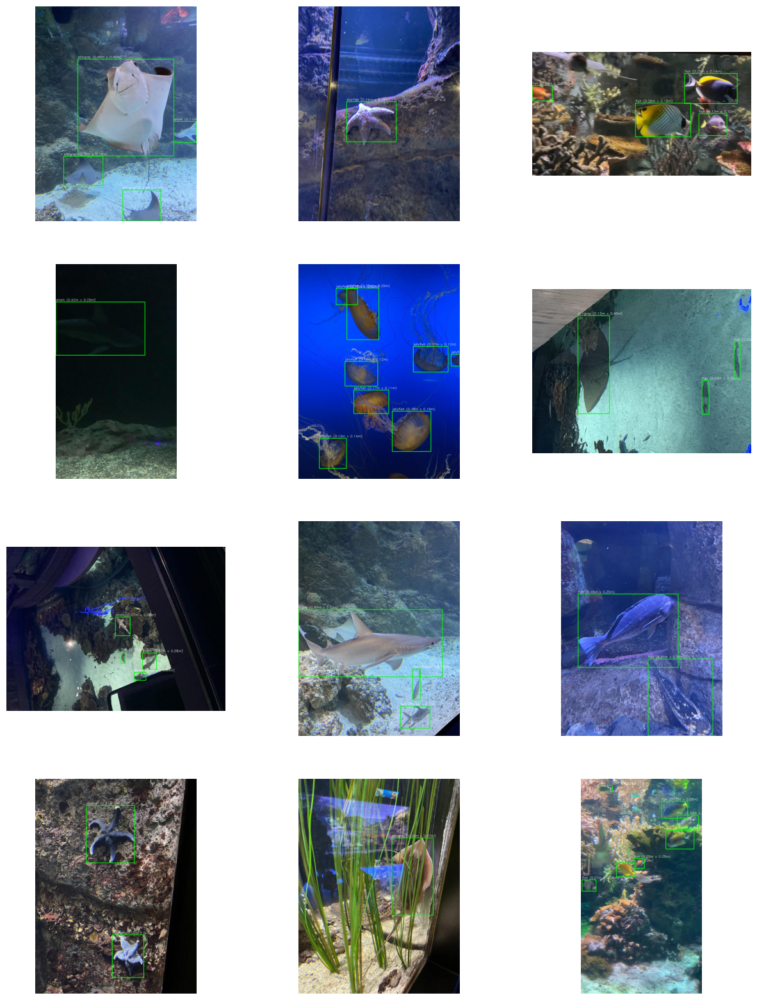

In [9]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Define the directories for training images and labels
TRAIN_IMAGES = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/images'
TRAIN_LABELS = '/kaggle/input/aquarium-data-cots/aquarium_pretrain/train/labels'

# Mapping of class indices to labels (update with your actual labels)
Idx2Label = {0: 'fish', 1: 'jellyfish', 2: 'penguin', 3: 'puffin', 4: 'shark', 5: 'starfish', 6: 'stingray'}

# Conversion factor from pixels to meters (adjust based on actual image scale)
pixels_to_meters = 0.001  # Example: 1 pixel = 0.001 meters

# Function to visualize images with annotation bounding boxes
def visualize_image_with_annotation_bounding_boxes(image_dir, label_dir):
    image_files = sorted(os.listdir(image_dir))
    sample_image_files = random.sample(image_files, 12)  # Randomly select 12 images

    fig, axs = plt.subplots(4, 3, figsize=(15, 20))

    for i, image_file in enumerate(sample_image_files):
        row = i // 3
        col = i % 3

        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        label_path = os.path.join(label_dir, image_file[:-4] + ".txt")
        
        # Check if the label file exists to avoid errors
        if not os.path.exists(label_path):
            print(f"No label file found for {image_file}, skipping...")
            continue
        
        with open(label_path, "r") as f:
            for label in f:
                class_id, x_center, y_center, width, height = map(float, label.split())
                h, w, _ = image.shape
                x_min = int((x_center - width / 2) * w)
                y_min = int((y_center - height / 2) * h)
                x_max = int((x_center + width / 2) * w)
                y_max = int((y_center + height / 2) * h)
                
                # Calculate bounding box dimensions in meters
                box_width_m = (x_max - x_min) * pixels_to_meters
                box_height_m = (y_max - y_min) * pixels_to_meters
                
                # Draw the bounding box
                cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
                
                # Display class label and dimensions in meters
                label_text = f"{Idx2Label.get(int(class_id), 'Unknown')} ({box_width_m:.2f}m x {box_height_m:.2f}m)"
                cv2.putText(
                    image,
                    label_text,  # Display the label and size
                    (x_min, y_min - 5),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=0.5,
                    color=(255, 255, 255),
                    thickness=1,
                )

        axs[row, col].imshow(image)
        axs[row, col].axis("off")

    plt.show()

# Run the visualization function
visualize_image_with_annotation_bounding_boxes(TRAIN_IMAGES, TRAIN_LABELS)
